<h1><center>Unsupervised and Supervised Analysis of 
Students Failure and Withdrawal from a Module at The Open University.  <br/>
<br/>
<br/>
<br/></center></h1>
<br/>
<br/>

<h1><center>Abstract</center></h1>

<p>Understanding the insights from learning analytics and clickstream data of online learning platform can aid in designing better online courses and increasing course completion rates among students. This study explores both supervised and unsupervised analysis techniques to uncover patterns and make predictions on the chances of a student failing or withdrawing from a course, using data from the Open University Learning Analytics dataset. Due to the current global pandemic forcing most students to start taking their courses online, it's imperative for schools and course designers to start exploring ideas to promote better engagement, and upstream  efforts to detect at risk students. The unsupervised models in this study explored KMeans algorithm, Hierarchial clustering, MeanShift algorithm and DBSCAN algorithm. The classification models explored are Decision Trees, Naive Bayes Classifier, and Support Vector Machines. The regression analysis was completed using Support Vector Regression, GradientBoostingRegressor, and RandomForestRegressor.   </p>

# 1.0 Introduction

<p> The learning analytics research group at the Knowledge Media institute, The Open University, has provided a publicly accessible dataset called Open University Learning Analytics dataset. This dataset contains data on students’ undertaking 7 selected modules and their interactions with the university’s VLE (Virtual Learning Environment). This dataset has 3 categories, which are Student demographics, Student Activities and Module Presentation. The Student Demographics data includes information about the student such as their location, age, final results e.t.c. The Student activities section includes data on the student interactions with their courses and the virtual learning platform. Module presentation holds information about the 7 selected modules this dataset was based on. </p>
<p>Student information data will be used for building the machine learning models, we will be using feature extraction techniques to create features from the original dataset, such as Weighted grades and exam scores of the students to be used for the regression models. We will assess the performance of the different models built and find the most suitable for this dataset.
Additionally, We will perform classification tasks on the students final result to detect failure or withdrawal.</p>

# 2.0 Methods and Methodology

<p>The aim of this study was to predict if a student would fail or withdraw from a course, statistical and machine learning tools were used to complete this aim. We started by applying data exploration techniques to this data to have a feel of the information each table in the dataset offers. The exploration was divided into two parts, graphical and numerical exploration. We applied feature extraction techniques to create three summary tables for the 3 sections we have in the dataset namely, student related actvivities, the vle platform and the course related information. Dimensionality reduction tools such as Principal component analysis was used to reduce the dimensionality of some of the dataset and we used the t-stochastic neighbour embedding plot to visualize our datapoints in a 2 dimension dataplane to visualize the relative distances between the datapoints. The KMeans algorithm, hierarchical clustering, MeanShift algorithm and DBSCAN techniues were used to explore our dataset. The feature selection process was done by removing highly correlated features, low variance features and using the Recursive Feature Elimination to select important features. We applied classification tools such as Naive Bayes classifier, Decision Trees and Support Vector Machine Algorithm. The regression task in this study was completed using the Support Vector Regression, GradientBoostingRegressor, and RandomForestRegressor.</p>

<p>The entire study was done using the Python software environment and the numerous statistical and machine learning packages:
</p>

 * Pandas: We used the pandas package and its various functions to manipulate and explore the dataet.
 * Numpy: The numpy package was used for numerical calculations and manipulations of our data.
 * Matplotlib.pyplot: This package was used to provide graphical representations of the findings from the dataset.
 * Seaborn: Seaborn was used to provide graphical interface for our plots.
 * Plotly: The plotly package was used to create 3-Dimensional and interactive plots.
 * Sklearn: The sklearn package was extensively used in this task, all machine learning modules used for this task were imported from the scikit-learn package.
 * Scipy: The scipy module was used for the creation of dendrograms in this study.
 
 <strong>Note: To get optimum performance from this notebook, it is adviseable to run the notebook from top down as some of the variables might change based on the part of the code being implemented.</strong>

In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [2]:
#loading all required packages
import pandas as pd
from pandas import plotting
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
import os
import glob
import seaborn as sns
from os import path
sns.set()

# for interactive visualizations
import plotly.express as px
import plotly.offline as py
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
from plotly import tools
init_notebook_mode(connected = True)
import plotly.figure_factory as ff

## 2.1   Task A: Data Preprocessing and Exploratory Analysis 

In [3]:
#define the file path
file_path = '/home/kp/Documents/ML/30028762/open-university-learning-analytics-dataset'

All the files were loaded into individual variables.

In [4]:
#loading data
assessments = pd.read_csv(file_path + '/' + 'assessments.csv')
courses = pd.read_csv(file_path + '/' + 'courses.csv')
studentAss = pd.read_csv(file_path + '/' + 'studentAssessment.csv')
studentInfo = pd.read_csv(file_path + '/' + 'studentInfo.csv')
studentReg = pd.read_csv(file_path + '/' + 'studentRegistration.csv')
studentVle = pd.read_csv(file_path + '/' + 'studentVle.csv')
vle = pd.read_csv(file_path + '/' + 'vle.csv')

### Data Schema and ERD Assumptions

<img src="schema.png">

### ERD ASSUMPTIONS


<u>courses to assessments:</u> The erd for this database shows that courses has a one to many relationships with the assessments. This means one course can have multiple assessments in the assessment table.

<u>Courses to vle:</u> This is a one to many relationship. One of the courses being offered can have many related materials on the vle.

<u>Courses to studentRegistration:</u> This is a one to many relationship. One course can have multiple students registered to take the course.

<u>Courses to studentinfo:</u> This is a one to many relationship. One course can have multiple students registered to take the course.

<u>Assessments to studentAssessment:</u> This is a one to many relationship. one assessment can have many students taking the assessment.

<u>studentinfo to StudentAssessment:</u> This is a one to many relationship. One student in our student information table can have multiple assessemtns in the StudentAssessment table.

<u>studentinfo to studentvle:</u> This is a one to many relationship because a student can have multiple enteries in the studentvle

<u>vle to studentvle:</u> This is a one to many relationship. one vle material can have multiple students using it.

<u>studentinfo to studentRegistration:</u> This is a one to many relationship. A student can have many registration.

#### Outcome from ERD Analysis
From the outcome of analyzing the ERD assumptions above we notice that due to the fact that our datasets are in a normal form some redundancyexists in the relationship among the different tables. An example is the Courses-studentRegistration and Courses-studentinfo where in both cases the relationship is similar. We would proceed with the feature engineering by denormalizing our database.

### Database Exploratory Analysis 

<img src="eplorere.gif">

We notice noticed in the database our data is grouped into 3 units, the Student-activities, Module Presentation and Student Demographics. We will group our exploratory analysis into these categories also, deriving insights and new ideas from the data in the different units. 

### 2.1.1 Module presentation Analytics
In this section we will summarize and analyze the details of all the courses being offered using the assessments, courses and vle tables. We created a function for our numerical exploration which can be found in the cell below.

In [5]:
def explore_data(data):
    '''This is a function to return a numerica eda of the data'''
    return data.head(),data.isnull().sum(),data.info(),data.describe(),data.count(),data.shape

### Assessments EDA 
Exploratory analysis on the Assessments table.

* Summary of the null values in the dataset shows only the date column has null values(11 null values) this is not going to affect our analysis since in the description of this table it has been stated that dates with zero are dates where the assessments were submitted on the starting date of the presentation so we will assume the 11 missing values were for assessments submitted on the start of the module-presentation
* A description of the data shows that we have a total of 206 instances in the dataset. The id_assessment is a categorical feature, we have the average date an assessment is submitted is 145 days after the start of the module. the average weight of each assessment is around 20 which is pulled up by the fact that exams are capped at 100. 
* The dataset has 206 instances with 6 columns
* We noticed DDD 2013B has the highest amount of total assessments among all courses.
* TMA assessments types are the most common assessments given to the students.

#### Quantitative EDA

In [6]:
#call the numerical eda function explore_data
ast_head,ast_sum_null,ast_info,ast_describe,ast_count,ast_shape = explore_data(assessments)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 206 entries, 0 to 205
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   code_module        206 non-null    object 
 1   code_presentation  206 non-null    object 
 2   id_assessment      206 non-null    int64  
 3   assessment_type    206 non-null    object 
 4   date               195 non-null    float64
 5   weight             206 non-null    float64
dtypes: float64(2), int64(1), object(3)
memory usage: 9.8+ KB


In [7]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#ast_sum_null
#ast_describe
ast_shape
#ast_count
#ast_head

(206, 6)

#### Graphical EDA 
In this subsection we will explore the dataset graphically

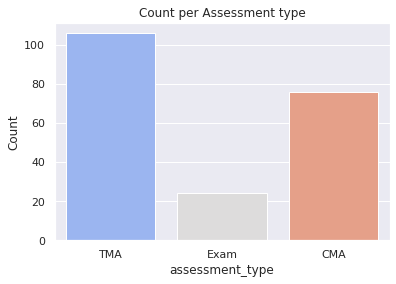

In [8]:
# Counts per assessment type
counts = sns.countplot(x='assessment_type', data=assessments, palette='coolwarm')
counts.set(xlabel='assessment_type', ylabel='Count', title='Count per Assessment type')
plt.show()

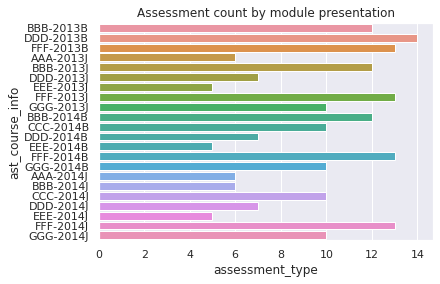

In [9]:
#do a count of the assessments by each module presentation
ast_grouped = assessments[['code_module','code_presentation','assessment_type']].\
groupby(['code_presentation','code_module']).count()
ast_grouped =ast_grouped.reset_index()

#add a new key for each course by mergine code_presentation and code module
ast_grouped['ast_course_info'] = ast_grouped['code_module'].str.cat(ast_grouped['code_presentation'],sep="-")


_ = sns.barplot(x = 'assessment_type', y = 'ast_course_info',  data= ast_grouped).set_title\
("Assessment count by module presentation")
#set the size of the fig
#sns.set(rc={'figure.figsize':(17.7,12.27)})
plt.show()

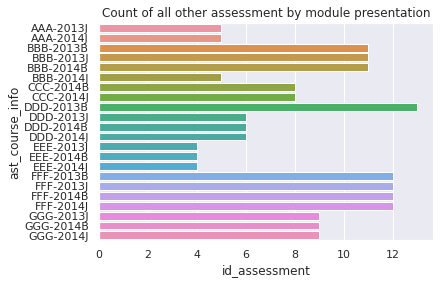

In [10]:
#we will be removing the assessment type with exams and look at the count
#--------------------------------------------------------------------------
#getting total assessment weight by module presentation for all assessment type except exams
exams_ast=assessments[assessments["assessment_type"]=="Exam"]
other_ast=assessments[assessments["assessment_type"]!="Exam"]
other_ast_grouped=other_ast.groupby(["code_module","code_presentation"]).count()["id_assessment"] 
other_ast_grouped=other_ast_grouped.reset_index()
other_ast_grouped['ast_course_info'] = other_ast_grouped['code_module'].str.cat(other_ast_grouped['code_presentation'],sep="-")

#plot weight distribution

_ = sns.barplot(x = 'id_assessment', y = 'ast_course_info',  data= other_ast_grouped).set_title\
("Count of all other assessment by module presentation")
plt.show()


### Courses EDA 
Exploratory analysis on the ccourses table

* We have no null values in the dataset, this is a data giving basic information about the courses being offered.
* There are a total number of 22 module presentation in this course and the average lenght for each module presentation is approximately 255 days
* The data has 22 instances and just 3 columns
* CCC-2014J, FFF-2014J and GGG-2014J had the highest module length among all module presentations

#### Quantitative EDA courses
In this subsection we will explore the numerical abstractions of the courses dataset.

In [11]:
#calling the explore data function
courses_head,courses_sum_null,courses_info,courses_describe,courses_count,courses_shape = explore_data(courses)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22 entries, 0 to 21
Data columns (total 3 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   code_module                 22 non-null     object
 1   code_presentation           22 non-null     object
 2   module_presentation_length  22 non-null     int64 
dtypes: int64(1), object(2)
memory usage: 656.0+ bytes


In [12]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#courses_sum_null
courses_head
#courses_describe
#courses_count
#courses_shape

,code_module,code_presentation,module_presentation_length
0,AAA,2013J,268
1,AAA,2014J,269
2,BBB,2013J,268
3,BBB,2014J,262
4,BBB,2013B,240


#### Graphical EDA Courses
We will explore the graphical representation of the dataset.

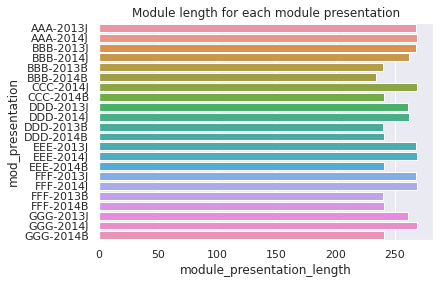

In [13]:
#adding a new key which is a combination of code presentation and module
courses['mod_presentation'] = courses['code_module'].str.cat(courses['code_presentation'],sep="-")
courses
#plotting module length by course
_ = sns.barplot(x = 'module_presentation_length', y = 'mod_presentation',  data= courses).set_title\
("Module length for each module presentation")
plt.show()

### Vle EDA 
In this section we will summarize details of all the courses being offered using the tables available in our database.

* We have a total of 6364 different materials in the vle and 6 variables in this dataset
* We have no nulll values present apart from the week_from and week_to column with approximately 80% of the data missing which will impact any analysis to be undertaken on this table. we will need to remove these two variables from the dataset.
* FFF-2013J had the highest amount of resources on the VLE platform and GGG-2014J had the least amount which is interesting because GGG-2014J is part of the courses with the highest module length and one would expect such a course to have a higher amount of resources based on its length.
* Materials named Resources had the highest occurence on the vle platform which is expected, we see pages url and subpages also having high occurence which is expected since these are just the links and page titles for the resources on the platform.

#### Quantitative EDA courses.

In [14]:
vle_head,vle_sum_null,vle_info,vle_describe,vle_count,vle_shape = explore_data(vle)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6364 entries, 0 to 6363
Data columns (total 6 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id_site            6364 non-null   int64  
 1   code_module        6364 non-null   object 
 2   code_presentation  6364 non-null   object 
 3   activity_type      6364 non-null   object 
 4   week_from          1121 non-null   float64
 5   week_to            1121 non-null   float64
dtypes: float64(2), int64(1), object(3)
memory usage: 298.4+ KB


In [15]:
#exploring the numerical estimations of the vle dataset
#vle_count
#vle_head
#vle_describe
vle_sum_null
#vle_shape

id_site                 0
code_module             0
code_presentation       0
activity_type           0
week_from            5243
week_to              5243
dtype: int64

In [16]:
#Dropping null values
vle.drop(columns=['week_from', 'week_to'],inplace=True)

#### Graphical EDA 

In [17]:
#create a new column merging code module and
#--------------------------------------
vle_temp = pd.merge(vle, courses,  how='left', left_on=['code_module','code_presentation'], right_on =\
               ['code_module','code_presentation'])
vle = vle_temp

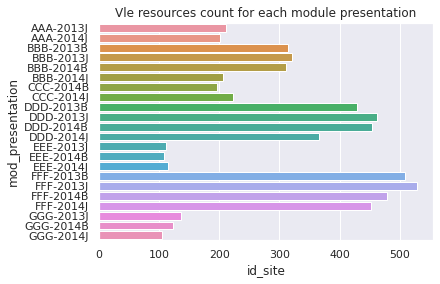

In [18]:
#getting the count of resourses by module presentation
vle_prst_res = vle.groupby(["mod_presentation"]).count()["id_site"]
vle_prst_res = vle_prst_res.reset_index()
#plotting count of resources by module
_ = sns.barplot(x = 'id_site', y = 'mod_presentation',  data= vle_prst_res).set_title\
("Vle resources count for each module presentation")
plt.show()

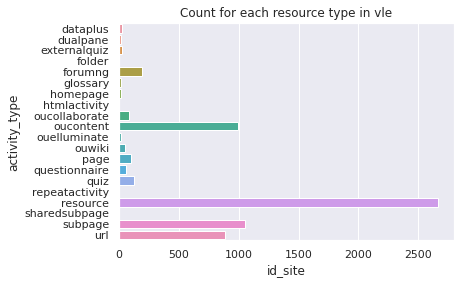

In [19]:
#grouping data by the activity type and performing a count for each group
vle_res_cnt = vle.groupby(["activity_type"]).count()["id_site"]
vle_res_cnt = vle_res_cnt.reset_index()
_ = sns.barplot(x = 'id_site', y = 'activity_type',  data= vle_res_cnt).set_title\
("Count for each resource type in vle")
plt.show()

### 2.1.2  Student Activities Analytics
In this section we will summarize and analyze the details of the student activities on and off the platform using the studentVle, studentAss and studentReg tables. We created a function for our numerical exploration which can be found in the cell below.

### Studentvle EDA 
In this section we will summarize details of all the student activities on the vle platform using table StudentVle

* We have no null values in this dataset
* We have a total of 10655280 daily logged sessions for all courses and students using the vle platform and 6 columns
* We have an average 3.7 interactions 3.7 clicks per student per site visited per day
* We have a minimum of 1 interaction per day per student and maximum value of 6977. This means we have more student with low levels of interactions based on the mean value of 3.7 interactions
* We have most of the students with around 5,000 to 10,000 clicks and a few with 15,000 to around 25,000 clicks
* FFF-2014J and FFF-2013J had the highest amount of interactions on the vle and GGG-2014B and GGG-2014J had the least amount of interactions

#### Quantitative EDA 

In [20]:
#using the explore data function for numerial analysis
studvle_head,studvle_sum_null,studvle_info,studvle_describe,studvle_count,studvle_shape = explore_data(studentVle)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10655280 entries, 0 to 10655279
Data columns (total 6 columns):
 #   Column             Dtype 
---  ------             ----- 
 0   code_module        object
 1   code_presentation  object
 2   id_student         int64 
 3   id_site            int64 
 4   date               int64 
 5   sum_click          int64 
dtypes: int64(4), object(2)
memory usage: 487.8+ MB


In [21]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#studvle_head
#studvle_sum_null
#studvle_describe
#studvle_count
studvle_shape

(10655280, 6)

#### Graphical EDA 

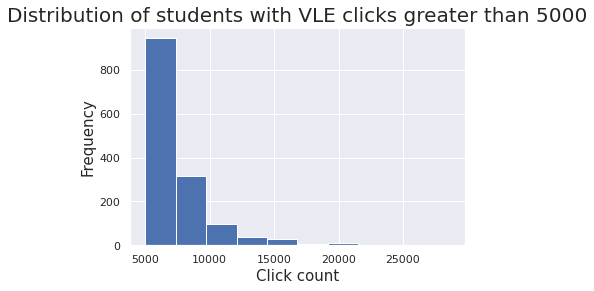

In [22]:
#who are the top interactors with the vle platform?
#group data by student and get their total clicks on the vle
std_vle_intrct = studentVle.groupby(["id_student"]).sum()["sum_click"].reset_index()
std_vle_intrct = std_vle_intrct.sort_values(by='sum_click', ascending=False)
#plot histogram with more than 5,000 clicks on the platform
studvle_5000 = std_vle_intrct[std_vle_intrct['sum_click'] >= 5000]
_ = plt.hist(studvle_5000['sum_click'],bins=10)
_ = plt.xlabel('Click count',fontsize=15)
_ = plt.ylabel('Frequency',fontsize=15)
__ = plt.title('Distribution of students with VLE clicks greater than 5000', fontsize = 20)

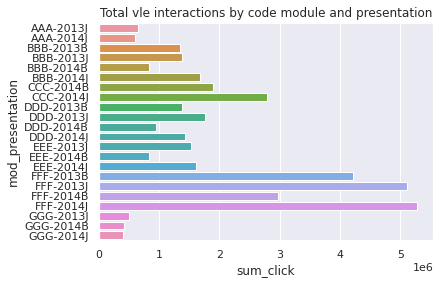

In [23]:
#merge with the courses table to get code module and presentation
student_vle_temp = pd.merge(studentVle, courses,  how='left', left_on=['code_module','code_presentation']\
                            , right_on =['code_module','code_presentation'])
#which courses have the most interaction?
course_vle_intrct = student_vle_temp.groupby(["mod_presentation"]).sum()["sum_click"].reset_index()

_ = sns.barplot(x = 'sum_click', y = 'mod_presentation',  data= course_vle_intrct).set_title\
("Total vle interactions by code module and presentation")
plt.show()

### studentAss EDA 
In this section we will summarize details of all the student assessment related events

* We have no null value in all column apart from the score column with 173 null values, we will assume this 173 null values are scores of students who got 0 on the assessment
* We observe a total of 173912 instances in this dataset and 5 columns
* The average score on each of the assessments by the students is approximately 75
* The minimum score is 0 while the max value is 100
* The standard deviation from the mean is around 18.7%
* Histogram of the average assessment score by each student shows that most students in the dataset had an average assessent score between 65 and 80 which means most students in the dataset passed their respective courses.
* The ECDF plot confirms the observations from the above as we can see that only around 7% of the students had an average assessment score lesser than 40.
* We used the scatterplot to explore the best time a student can submit their assessments and discovered that students that submit assessments within the first 200 days of a course on a average stand a better chance of passing that those that submit after 200 days.
* We used the ECDF to confirm the observation on the best day to submit which showed that approximately none of the students that subitted within the first 200 days had lesser than an average of 60 while around 5% of those that submitted after 200 dats got lesser than 40%

#### Quantitative EDA

In [24]:
#calling the explore data function
studentAss_head,studentAss_sum_null,studentAss_info,studentAss_describe,studentAss_count,studentAss_shape\
= explore_data(studentAss)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 173912 entries, 0 to 173911
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   id_assessment   173912 non-null  int64  
 1   id_student      173912 non-null  int64  
 2   date_submitted  173912 non-null  int64  
 3   is_banked       173912 non-null  int64  
 4   score           173739 non-null  float64
dtypes: float64(1), int64(4)
memory usage: 6.6 MB


In [25]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#studentAss_head
#studentAss_sum_null
#studentAss_info
studentAss_describe
#studentAss_count
#studentAss_shape

,id_assessment,id_student,date_submitted,is_banked,score
count,173912.000000,1.739120e+05,173912.000000,173912.000000,173739.000000
mean,26553.803556,7.051507e+05,116.032942,0.010977,75.799573
std,8829.784254,5.523952e+05,71.484148,0.104194,18.798107
min,1752.000000,6.516000e+03,-11.000000,0.000000,0.000000
25%,15022.000000,5.044290e+05,51.000000,0.000000,65.000000
50%,25359.000000,5.852080e+05,116.000000,0.000000,80.000000
75%,34883.000000,6.344980e+05,173.000000,0.000000,90.000000
max,37443.000000,2.698588e+06,608.000000,1.000000,100.000000


#### Graphical EDA

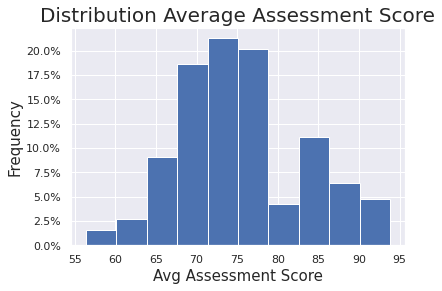

In [26]:
#getting the average score per assessment by students
ass_avg = studentAss.groupby(["id_assessment"]).mean()["score"].reset_index()
#convert the values to numpy arrays
score_array = ass_avg['score'].values
#plotting histogram of assessment average scores
_ = plt.hist(score_array,weights=np.ones(len(score_array)) / len(score_array))
plt.gca().yaxis.set_major_formatter(PercentFormatter(1))
_ = plt.xlabel('Avg Assessment Score',fontsize=15)
_ = plt.ylabel('Frequency',fontsize=15)
_ = plt.title('Distribution Average Assessment Score', fontsize = 20)
plt.show()

In [27]:
#plotting the cumulative distribution of the students average scores
def ecdf(data):
    '''function to create cumulative distribution frequency'''
    #number of data points : n
    n = len(data)
    #x-data for the ecdf : x
    x = np.sort(data)
    #ecdf data goes from 1/n to 1
    y = np.arange(1, len(data)+1)/len(data)
    return x,y

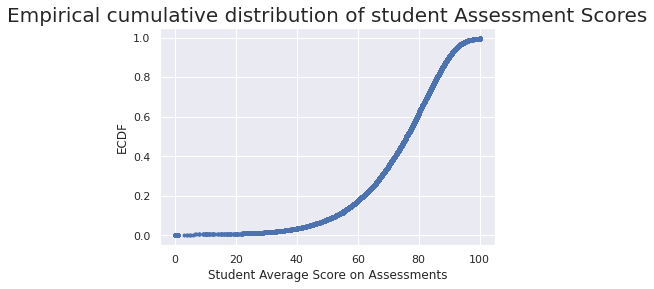

In [28]:
#getting the average assessment score by each student
stdass_avg = studentAss.groupby(["id_student"]).mean()["score"].reset_index()
# Compute ECDF for student assessment average data: x_std_avg, y_std_avg
x_std_avg,y_std_avg = ecdf(stdass_avg['score'].values)
# Generate plot
_ = plt.plot(x_std_avg,y_std_avg,marker='.',linestyle = 'none')

# Label the axes
_= plt.xlabel('Student Average Score on Assessments')
_ = plt.ylabel('ECDF')
_ = plt.title('Empirical cumulative distribution of student Assessment Scores', fontsize = 20)

# Display the plot
plt.show()


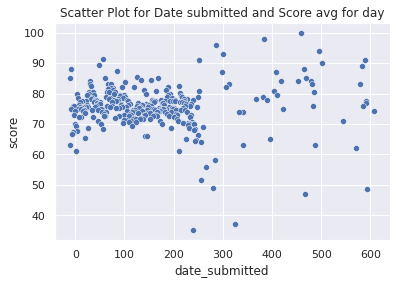

In [29]:
#when is the best time to submit assessment?
score_per_date = studentAss.groupby(["date_submitted"]).mean()["score"].reset_index().\
sort_values(by='score', ascending=False)
#scatterplot for submission date and average score
_ = sns.scatterplot(data=score_per_date, x="date_submitted", y="score").\
set_title("Scatter Plot for Date submitted and Score avg for day")
plt.show()

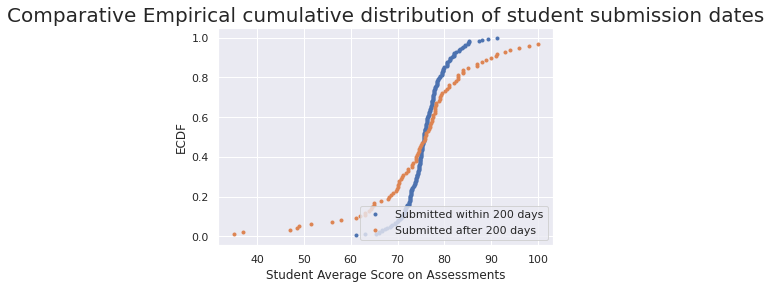

In [30]:
#Do students who submit early stand a better chance of passing?
sub_btw_200 = score_per_date[score_per_date['date_submitted'] <= 200]
sub_aft_200 = score_per_date[score_per_date['date_submitted'] > 200]

# Compute ECDF for student that submit within 200 days and after 200 days of course start date
#ecdf students within 200
x_std_200,y_std_200 = ecdf(sub_btw_200['score'].values)
#ecdf students after 200
x_std_a200,y_std_a200 = ecdf(sub_aft_200['score'].values)
# Generate plot
_ = plt.plot(x_std_200,y_std_200,marker='.',linestyle = 'none')
_ = plt.plot(x_std_a200,y_std_a200,marker='.',linestyle = 'none')


# Label the axes
_ = plt.legend(('Submitted within 200 days', 'Submitted after 200 days'), loc='lower right')
_= plt.xlabel('Student Average Score on Assessments')
_ = plt.ylabel('ECDF')
_ = plt.title('Comparative Empirical cumulative distribution of student submission dates', fontsize = 20)

# Display the plot
plt.show()


### studentReg EDA 
We will be exploring how the students register for their courses and discover trends and insights from the studentReg table.

* We 45 null values for date_registration and 22,521 null for date_unregistration. This means we have 45 students who registered on the day the module presentation start day and 22,521 students who completed the course and some who withdrew from the course.
* We have a total of 32593 registration for different courses by students and 5 variables capturing details of the students registration
* The plot of date of registration showed that most students register for courses around a month or two before the start date of the particular module presentation
* CCC-2014J had the highest amount of registered students and AAA-2014J had the least amount of registered students
* More students register for courses that starts during the J session i.e courses starting in October has more registered students than those starting in February on a average.

#### Quantitative EDA 

In [31]:
#calling the explore data function
studentReg_head,studentReg_sum_null,studentReg_info,studentReg_describe,studentReg_count,\
studentReg_shape = explore_data(studentReg)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32593 entries, 0 to 32592
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   code_module          32593 non-null  object 
 1   code_presentation    32593 non-null  object 
 2   id_student           32593 non-null  int64  
 3   date_registration    32548 non-null  float64
 4   date_unregistration  10072 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 1.2+ MB


In [32]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#studentReg_head
#studentReg_sum_null
#studentReg_info
#studentReg_describe
#studentReg_count
studentReg_shape

(32593, 5)

#### Graphical EDA 

In [33]:
#add new instance key by combining code module and presentation
studentReg['mod_presentation'] = studentReg['code_module'].str.cat(studentReg['code_presentation'],sep="-")

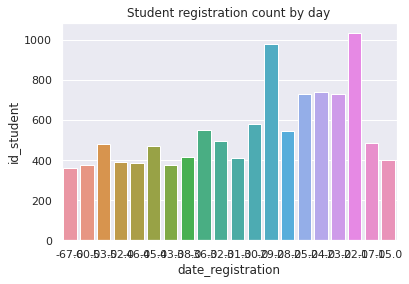

In [34]:
#when do most student register for courses?
reg_date = studentReg.groupby(["date_registration"]).count()["id_student"].reset_index\
().sort_values(by='id_student', ascending=False)
#get the top 20 days for registration
reg_date_10 = reg_date.head(20)
#plotting the top 20 days
_ = sns.barplot(x = 'date_registration', y = 'id_student',  data= reg_date_10).set_title\
("Student registration count by day")
plt.show()

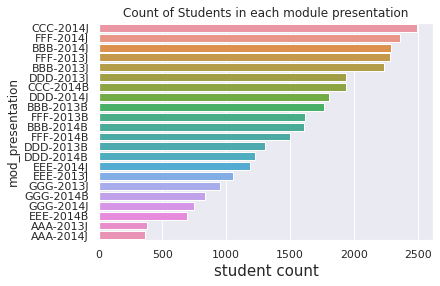

In [35]:
#which courses have most registration
most_reg_course =studentReg.groupby(["mod_presentation"]).count()["id_student"].reset_index().sort_values\
(by='id_student', ascending=False)

#plot of courses with highest registration
_ = sns.barplot(x = 'id_student', y = 'mod_presentation',  data= most_reg_course).set_title\
("Count of Students in each module presentation")
_ = plt.xlabel('student count',fontsize=15)
plt.show()


In [36]:
#creating mapping for the different module presentations in the dataset
temp_maps = {'2013J':'J', '2014J':'J','2014B':'B', '2013B':'B'}
#use lambda function to apply function across the column top down
studentReg['Module_Session']= studentReg['code_presentation'].apply(lambda x:temp_maps[x])

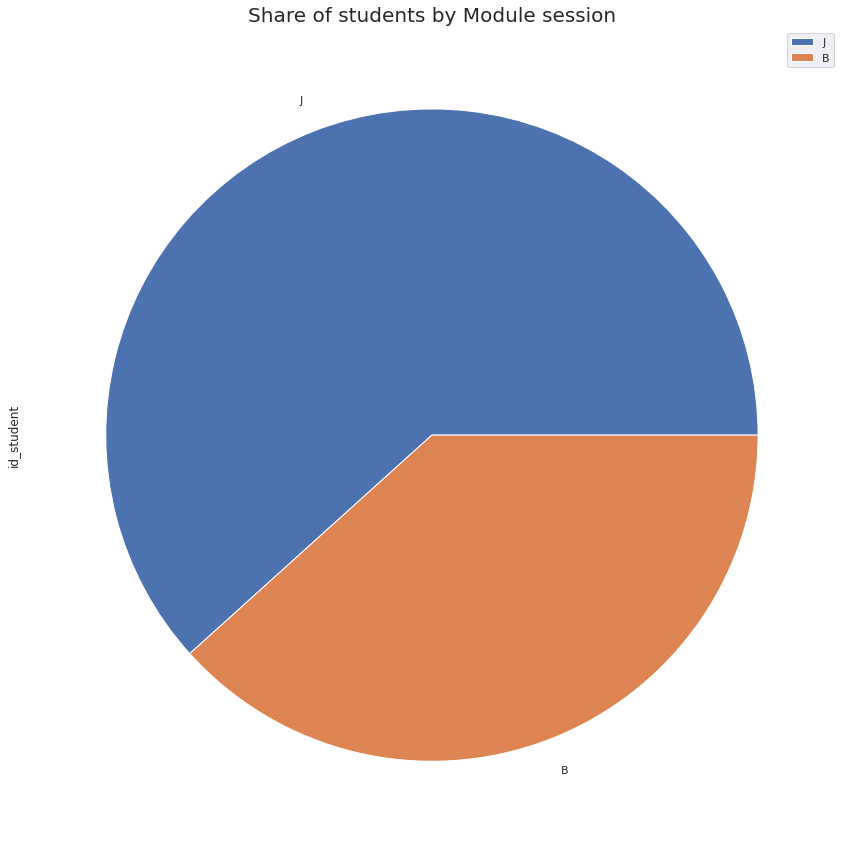

In [37]:
#which courses have most registration
Mod_session_cnt = studentReg.groupby(["Module_Session"]).count()["id_student"].\
reset_index().sort_values(by='id_student', ascending=False)
#plotting the pie plot
plot = Mod_session_cnt.set_index('Module_Session').plot.pie(y='id_student',figsize=(15, 15))
_ = plt.title('Share of students by Module session', fontsize = 20)

### 2.1.3  Student Activities Analytics
In this section we will summarize details of all the students, their grade history and demographics.

* We have 1,111 null values in the imd_band column, we will assume students with null values for this features are in regions with no Depravation hence the null values
* We have a total of 32593 instances in this dataset reperesenting students details, courses they took and their grades.
* All the students in this dataset took an average of 80 study credits
* The minimum credits taken was 30 units while the maximum was 655. we assume students with study credit more than 120 are not that much in the dataset
* Scotland is the region with the highest total of students registered for courses in the open learning platform, and Ireland has the least amount of students registered.
* We observed that around 15 courses had more Male students taking the courses while around 7 courses had more Female students taking the courses.
* A pie chart of the distribution of grades show that more student passed the course than fail and a sensible amount of students had distinctions. We observe that we have a hig rate of withdrawal.

The Index of Mmultiple deprivation is the United Kingdom's measure of relative deprivation for small areas. The percentages of the IMD in this dataset can be interpreted as.

10% is classified as the most deprived regions <br/>
10-20% are Most deprived regions<br/>
20-30%  are Most deprived regions<br/>
30-50% are Most deprived region<br/>
Greater than 50% is Least deprived region

* Based on the index above the plot shows the most deprived areas have a higher rate of student withdrawing from the courses. Further analysis can be done in this area to see how we can help students in regions with low IMD.
* All the courses have more students passing than failing and also all courses have students with distinctions.
* We see that all age groups have students who passed, got distinctions or failed the course, but we can observe that for the >55 age bracket all students who completed the course passed.
* We have most of the students withn the 0-35 age group and and around 20% of the students within the 35-55 age range while students in the greater than 55 group are very small.
* Using the strip plot we notice that the distribution of studied credits among Male and Female students are quite similar.

#### Quantitative EDA 

In [38]:
#calling the explore data function on the student information table
studentInfo_head,studentInfo_sum_null,studentInfo_info,studentInfo_describe,studentInfo_count,\
studentInfo_shape = explore_data(studentInfo)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32593 entries, 0 to 32592
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   code_module           32593 non-null  object
 1   code_presentation     32593 non-null  object
 2   id_student            32593 non-null  int64 
 3   gender                32593 non-null  object
 4   region                32593 non-null  object
 5   highest_education     32593 non-null  object
 6   imd_band              31482 non-null  object
 7   age_band              32593 non-null  object
 8   num_of_prev_attempts  32593 non-null  int64 
 9   studied_credits       32593 non-null  int64 
 10  disability            32593 non-null  object
 11  final_result          32593 non-null  object
dtypes: int64(3), object(9)
memory usage: 3.0+ MB


In [39]:
#numerical exploratory analysis of the data: (pls note) uncomment each variable below to see the content
#studentInfo_head
#studentInfo_sum_null
#studentInfo_info
studentInfo_describe
#studentInfo_count
#studentInfo_shape

,id_student,num_of_prev_attempts,studied_credits
count,3.259300e+04,32593.000000,32593.000000
mean,7.066877e+05,0.163225,79.758691
std,5.491673e+05,0.479758,41.071900
min,3.733000e+03,0.000000,30.000000
25%,5.085730e+05,0.000000,60.000000
50%,5.903100e+05,0.000000,60.000000
75%,6.444530e+05,0.000000,120.000000
max,2.716795e+06,6.000000,655.000000


#### Graphical EDA 

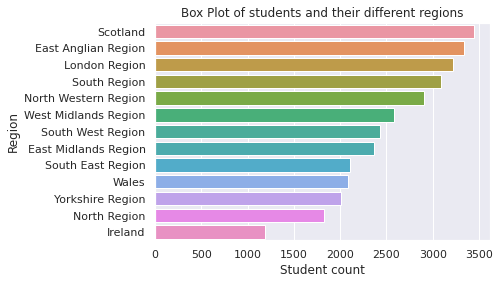

In [40]:
#add new instance key for each row in the dataset
studentInfo['mod_presentation'] = studentInfo['code_module'].str.cat(studentInfo['code_presentation'],sep="-")
studentInfo.head()
#group all students by the regions they are from.
region_std_cnt = studentInfo.groupby(["region"]).count()\
["id_student"].reset_index().sort_values(by='id_student', ascending=False)

#plotting boxplot of the student by courses and region
_ = sns.barplot(x = 'id_student', y = 'region', data= region_std_cnt, orient="h").\
    set_title("Box Plot of students and their different regions")
#create the x axis label
_ = plt.xlabel('Student count')
#create the y axis label
_ = plt.ylabel('Region')
plt.show()

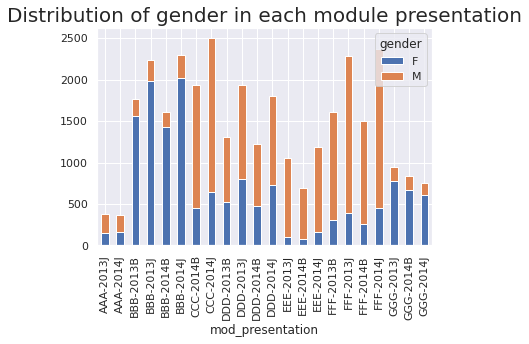

In [41]:
#group students by gender and courses
gender_temp =studentInfo.groupby(["gender",'mod_presentation']).count()\
["id_student"].reset_index().sort_values(by='id_student', ascending=False)
#get the count of each gender for each module presentation
gender_course_cnt = gender_temp.set_index(['mod_presentation','gender']).id_student \
.unstack().reset_index()
#get a stack plot showing courses and amount of gender for each course
_ = gender_course_cnt.set_index('mod_presentation')[['F','M']].plot(kind='bar', stacked=True)
_ = plt.title('Distribution of gender in each module presentation', fontsize = 20)

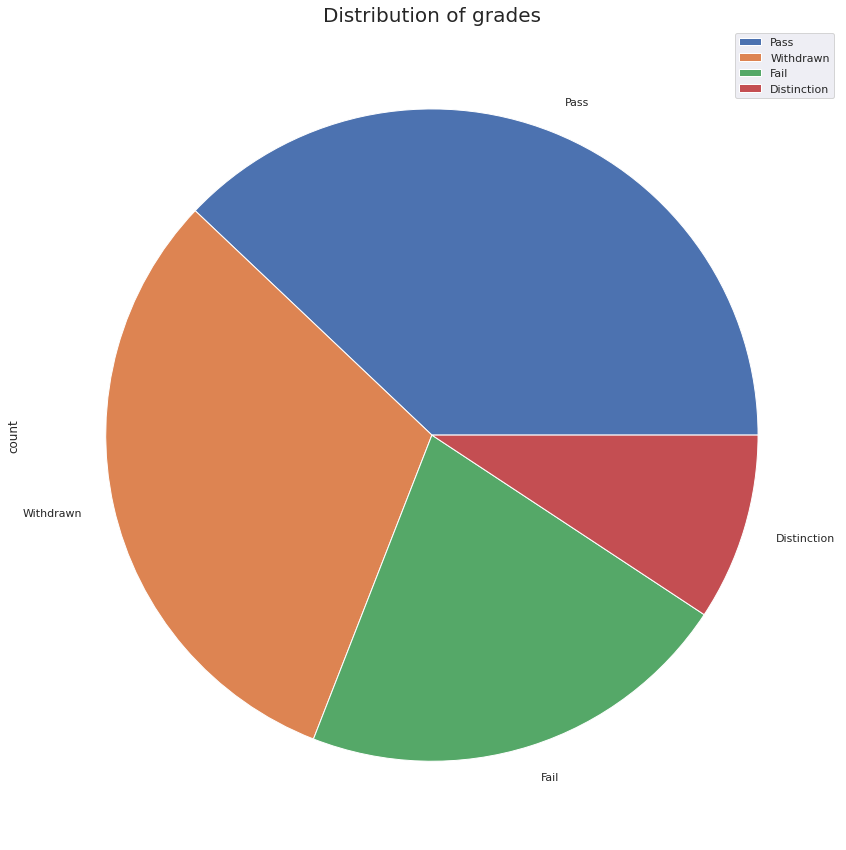

In [42]:
#converting the distinct count of result categories to a dataframe
# value_counts as dataframe
stud_results_cat = studentInfo['final_result'].value_counts().to_frame().reset_index()
stud_results_cat = stud_results_cat.rename(columns={"index": "result_cat", "final_result": "count"})

plot = stud_results_cat.set_index('result_cat').plot.pie(y='count',figsize=(15, 15))
_ = plt.title('Distribution of grades', fontsize = 20)

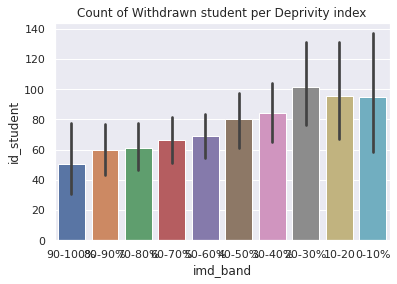

In [43]:
#what is the distribution of withdrawn students based on their IMD region index
withdrawn_std = studentInfo[studentInfo['final_result'] == 'Withdrawn']
withdrawn_std = withdrawn_std.groupby(['region','imd_band']).count()\
["id_student"].reset_index().sort_values(by='imd_band', ascending=False)

#plot of deprivity by region
_ = sns.barplot(x = 'imd_band', y = 'id_student',  data= withdrawn_std).set_title\
("Count of Withdrawn student per Deprivity index")
plt.show()

The Index of Mmultiple deprivation is the United Kingdom's measure of relative deprivation for small areas. The percentages of the IMD in this dataset can be interpreted as.

* 10% is classified as the most deprived regions 
* 10-20% Most deprived regions
* 20-30% Most deprived regions
* 30-50% Most deprived region
* > 50%  Least deprived region

Based on the index above the plot shows the most deprived areas have a higher rate of student withdrawing from the courses. Further analysis can be done in this area to see how we can help students in regions with low imd

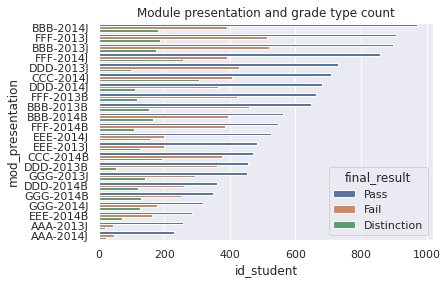

In [44]:
#What is the grade distribution for all module presentation
#select only students that have not withdrawn from the course
std_info_ = studentInfo[studentInfo['final_result'] != 'Withdrawn']
#group students based on their courses and grades
std_info_1 = std_info_.groupby(['mod_presentation','final_result']).count()\
["id_student"].reset_index().sort_values(by='id_student', ascending=False)


#plot a barplot showing different courses and their total grade groups
_ = sns.barplot(x = 'id_student', y = 'mod_presentation',hue='final_result',  data= std_info_1).set_title\
("Module presentation and grade type count")
plt.show()

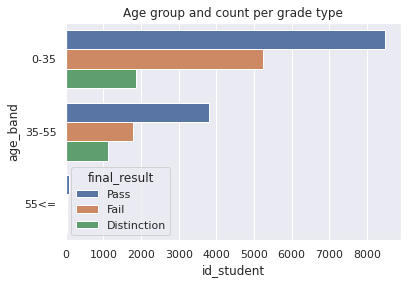

In [45]:
#what is the age distribution of all our students
#group student counts based on their final grade and age band
std_info_2 = std_info_.groupby(['age_band','final_result']).count()\
["id_student"].reset_index().sort_values(by='id_student', ascending=False)
#plot the age bands and the count of grade group for each age band
_ = sns.barplot(x = 'id_student', y = 'age_band',hue='final_result',  data= std_info_2).set_title\
("Age group and count per grade type")
plt.show()

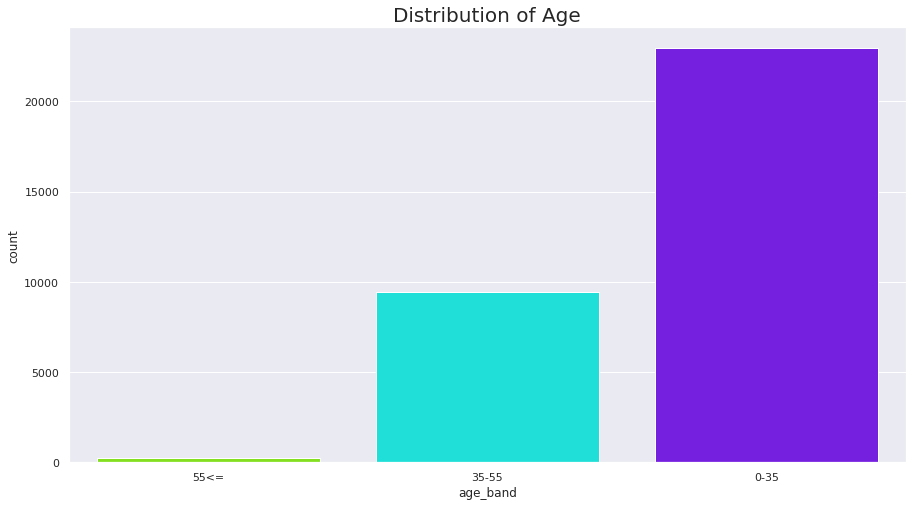

In [46]:
#plotting the age distribution for all students
plt.rcParams['figure.figsize'] = (15, 8)
sns.countplot(x = studentInfo['age_band'], palette = 'hsv')
plt.title('Distribution of Age', fontsize = 20)
plt.show()

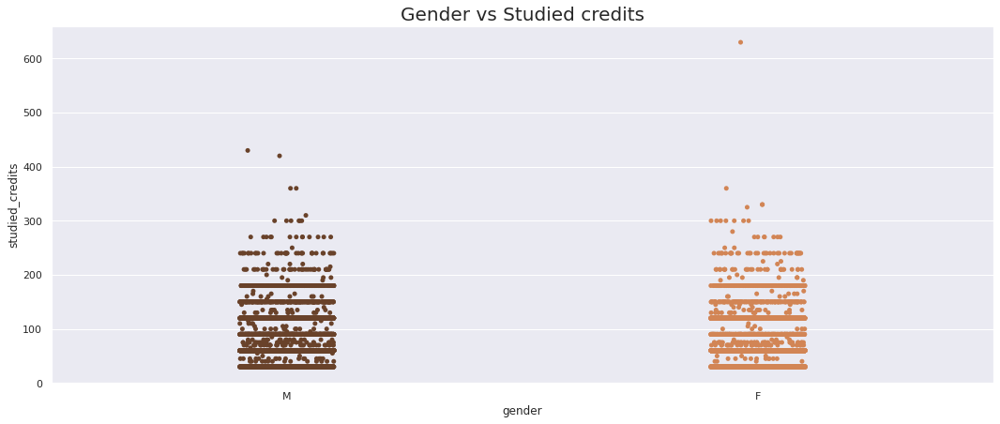

In [47]:
#plotting gender and thier studied credits
plt.rcParams['figure.figsize'] = (18, 7)
sns.stripplot(x = std_info_['gender'], y = std_info_['studied_credits'], palette = 'copper')
plt.title('Gender vs Studied credits', fontsize = 20)
plt.show()

## Insights from Exploratory Analysis

#### Module presentation Analytics
* TMA assesments are usually the highest type of assessments given to the students during the module presentation followed by CMA assessments. Exams has a lower amount because each module presentation has just one exam at the end of the module.
* DDD 2013B has the highest amount of assessments out of module presentations  in this dataset. FFF 2013B and FFF 2014J are the next in terms of highest assessments. EEE 2013J, EEE 2014B and EEE 2014J has the least amount of assessments counts.
* The average length of each module is 255. We observed that none of the module had a length lesser than 234 days.
* FFF 2013J had the highest amount of content on the VLE platform. EEE-2013J, EEE- 2014B and GGG-2014J had the least amount of materials on the VLE.
* Resource activity type or material had the highest count on the VLE platform which is expected since each course would have different resources on each topic or module that is being taught. We also noticed some activity on the forum pages.

#### Student Activities Analytics
* FFF 2014J has the highest amount of recorded activities followed by FFF 2013J and GGG 2014J has the least amount of activities
* Around 21% of the assessments had an average score of 70 - 75, around 20% of the assessments given had an average of 75 - 80. Around 25% of assessments had scores greater than 85 and around 13% had scores lesset than 65.
* We observed that generally student who submit assessments within the first 200 days of a module presentation have no average score lesser than 60, but those that submitted after 200 days tend to have high variance among the average score and average score is as low as 20% for this group.
* We observe highest amount of registration takes place before the start of a module presentation which is expected and the highest amount of registration occurs around a month before the start of the module presentation.
* CCC 2014J had the highest amount of registration and AAA 2014J had the least amount of registration.
* Courses starting in February on a average had a lesser amount of registration compared to courses starting in october.

#### Student Info Analytics
* Scotland has the highest average students taking the courses
* Around 70% of the courses had higher amount of male students taking the courses while 30% of the courses had a higher amount of female students taking them. 
* We noticed that most deprived regions had a higher rate of students withdrawing from the courses.
* BBB 2014J had the highest amount of students who passed, this is not the pass rate this might change if we consider pass rate and fail rate which considers the number of students taking the courses.
* students within the range of 0-35 had higher amount of passes which also might change when we consider pass rate.


##  2.2.0 Feature Engineering

<img src="featuemgineering.gif">


Since we have 3 different groups in our database which are Module presentation, Student activities and Student demographics. we will be creating a summarized table for each of this group which can then be used to decide the next step in the analysis. We would be taking this approach by Denormalization tables in each category till we have a single table for each group.

### 2.2.1  Table 1: Student activities 
We will be creating a flat table for all student related metrics that can aid in the implementation of machine learning algorithms on this data. The original data studentInfo includes information on the students with each instance reperesenting a student and their historical information on the courses they have taking, their scores and other details perculiar to each students. Based on the structure of this table there is a possibility we have a student appearing twice as the primary key for this table is a composite one including id of the student, the code module and code presentation reperesented by that instance, hence we can have a student with multiple instances of the courses they took. The evidence above shows that any addition to summarize details of the student will be grouped by the student ID, code module and code presentation level.

In [48]:
#creating a copy of the original table
std_info_tmp = studentInfo.copy()

In [49]:
#creating the mapping functions to be used in engineering a new table
#Function to determine whether a student passed a given assessment
def pass_fail(grade):
    if grade>=40:
        return 'Pass_AST'
    else:
        return 'Fail_AST'
#function to determine if a student took the final exam or not
def took_exam(exam_score):
    if exam_score ==0:
        return 'False'
    else:
        return 'True'

#### Creating features related to the score students got in assessments and exams

In this step we got the details of the assessment taken by a student by merging the student assessment details and the dimension table(other_ast) holding information on the assessment types. We joined the details of the exam scores and got the average the student got for both assessments and exams, this was then used to map if the student took exams or not. The assumption was that if a null value was found in the score column for exams this means the student did not take the exam. The idea behind the creation of the weighted assessment score was the fact that the sum of all weighted assessment for a course should be equal to 100.

In [50]:
#merge the studentAss table with the other_ast dataframe which holds details of non exam assessments
other_asst_weighted = pd.merge(studentAss,other_ast,how="inner",on=["id_assessment"])
#create a new column which shows the weighted grade for each assessment taken by the student
other_asst_weighted["ast_weighted_grade"]=other_asst_weighted["score"]*other_asst_weighted["weight"]/100
#Take a sum of the weighted grades for each student group by the id of the student and course details
other_asst_weighted = other_asst_weighted.groupby(["id_student","code_module","code_presentation"]).\
sum()["ast_weighted_grade"].reset_index()

#getting the exam scores
exam_score = pd.merge(studentAss,exams_ast,how="inner",on=["id_assessment"])
exam_score = exam_score.groupby(["id_student","code_module","code_presentation"]).\
sum()["score"].reset_index()


#getting the average for exam and assessments. use left join since not students will have exam score
tot_ast_score = pd.merge(other_asst_weighted,exam_score,how="left",on=["id_student","code_module",\
                                                                    'code_presentation'])


#we have null cause not all student have exams so convert to 0 so we can perform calculations on this column
tot_ast_score['score'] = tot_ast_score['score'].fillna(0)

#rename the score to exam score
tot_ast_score = tot_ast_score.rename(columns={"score": "Exam_score"})

#merging with student info table
std_info_final = pd.merge(std_info_tmp,tot_ast_score,how="inner",on=\
                          ["id_student","code_module","code_presentation"])


#### Creating features related to vle activities of the student for each course they took.

We created two new features detailing the students activity on the vle platform for each course they are taking. We got the average count of their clicks on the vle and their total click. Finally, we got the total number of distinct days a student visited the vle platform and interact with it.

In [51]:
#getting the vle count of the students by course
#total sum click daily for each student grouped by the student id and course details
studentVle_cnt = studentVle.groupby(["code_module","code_presentation","id_student"]).\
sum()["sum_click"].reset_index()

#joining with the std final table
std_info_final = pd.merge(std_info_final,studentVle_cnt,how="inner",on=\
                          ["id_student","code_module","code_presentation"])



#-----------------------getting average------------------------------------------------


#average sum click daily for each student grouped by student id and course details
studentVle_avg_click = studentVle.groupby(["code_module","code_presentation","id_student"]).\
mean()["sum_click"].reset_index()
studentVle_avg_click = studentVle_avg_click.rename(columns={"sum_click": "avg_daily_click"})

#joining with the std final table
std_info_final = pd.merge(std_info_final,studentVle_avg_click,how="inner",on=\
                          ["id_student","code_module","code_presentation"])

#-----------------------getting total distinct days student visited vle

#total number of days student interacted with the vle platform at least ones.distinct daily visit
std_visit_tmp = studentVle.groupby(["code_module","code_presentation","id_student","date"]).\
count()['sum_click'].reset_index()
std_visit = std_visit_tmp.groupby(["code_module","code_presentation","id_student"]).\
count()['date'].reset_index()
std_visit = std_visit.rename(columns={"date": "Distinct_intrct_days"})
#joining with final table
std_info_final = pd.merge(std_info_final,std_visit,how="inner",on=\
                          ["id_student","code_module","code_presentation"])


#### Creating features related to student registration.

To get the day a student register for a particular course we selected the needed columns from the original table(studentReg) this was merged with the student information table(std_info_final).

In [52]:
#date of registration
#selecing columns to add to new table
studentReg_dt = studentReg[['code_module','code_presentation','id_student',\
                            'date_registration','Module_Session','date_unregistration']]
std_info_final = pd.merge(std_info_final,studentReg_dt,how="inner",on=\
                          ["id_student","code_module","code_presentation"])

#### Creating features related to courses taken by the students.

We got the length of the course the student signed up for by merging with the course table which holds this information.

In [53]:
#adding course length to the table
std_info_final = pd.merge(std_info_final,courses,how="inner",on=\
                          ["code_module","code_presentation","mod_presentation"])

In [54]:
#creating a copy of the original dataset
std_info_final_copy = std_info_final.copy()

In [55]:
#checking for null values
std_info_final_copy.isnull().sum()

code_module                       0
code_presentation                 0
id_student                        0
gender                            0
region                            0
highest_education                 0
imd_band                        997
age_band                          0
num_of_prev_attempts              0
studied_credits                   0
disability                        0
final_result                      0
mod_presentation                  0
ast_weighted_grade                0
Exam_score                        0
sum_click                         0
avg_daily_click                   0
Distinct_intrct_days              0
date_registration                 4
Module_Session                    0
date_unregistration           21136
module_presentation_length        0
dtype: int64

#### Handling null values

We will create a function to show the percentage of null values for table entered as an argument.  We will be removing instances with null values when the null values for the features are not up to 5% of the features. Based on the outcome of the check for null values, we found null values in imd_band, avg_ast_score, date_registration and date_unregistration. We will be removing instances of null values for imd_band, avg_ast_score, and date_registration. For the date_unregistration we will be removing the entire feature since null values account for almost 81% of the entire feature.

In [56]:
#define function to return percentage missing
def percent_missing(inp):
    print("Percentage missing for "+ str(inp) +" is " + \
          str((std_info_final_copy[inp].isnull().sum()/len(std_info_final_copy)) * 100) + '%')



In [57]:
#count the null values of  imd_band feature and check percentage missing
percent_missing('imd_band')

Percentage missing for imd_band is 3.8658394726638234%


In [58]:
#count the null values of  date_registration
percent_missing('date_registration')

Percentage missing for date_registration is 0.015509887553315237%


In [59]:
#count the null values of  date_unregistration
percent_missing('date_unregistration')

Percentage missing for date_unregistration is 81.95424583171771%


In [60]:
#dropping null instances for null values for imd_band, avg_ast_score, and date_registration
#----------------------------------------------------------------------------------------------

#we will drop students who do not have imd_band  since this makes up less than 5% of the imd_band feature 
std_info_final_copy = std_info_final_copy[std_info_final_copy['imd_band'].notnull()]

#we will drop students who do not have imd_band  since this makes up less than 5% of the date_registration 
std_info_final_copy = std_info_final_copy[std_info_final_copy['date_registration'].notnull()]

#we will drop the date_unregistration  since almost 81% of the features are missing
std_info_final_copy = std_info_final_copy.drop(['date_unregistration'],axis=1)

#drop code module and presentation
std_info_final_copy =std_info_final_copy.drop(['code_module','code_presentation','id_student'],axis=1)

#### Feature extraction on IMD 

To simplify the IMD band feature we will convert the total groups to just two groups, deprived and NON-deprived.

In [61]:
#we will create a dual category for our imd_band feature. Deprived students and Non-deprived students
#convert imd band to str
std_info_final_copy['imd_band'] = std_info_final_copy['imd_band'].astype(str)
#create a dictionary of deprivity based on categorization stated above
deprivity_maps = {'30-40%' :'Deprived', '20-30%':'Deprived','10-20':'Deprived', '40-50%':\
                  'Deprived','50-60%':'Non-Deprived','0-10%':'Deprived','60-70%':'Non-Deprived',\
                  '70-80%':'Non-Deprived','80-90%':'Non-Deprived','90-100%':'Non-Deprived'}
#using lambda function to map the values
std_info_final_copy['imd_band_Deprivity']= std_info_final_copy['imd_band'].apply(lambda x:deprivity_maps[x])

#we will drop the imd band column since we have a new category for it
std_info_final_copy =std_info_final_copy.drop(['imd_band'],axis=1)

#### Feature extraction on Final Results

We will convert all students with distinctions and categorize them as passed to simplify the final results feature in our dataset.

In [62]:
#converting the distinctions to pass so we can have just 3 groups
dist_maps = {'Distinction' :'Pass','Pass' :'Pass','Fail':'Fail','Withdrawn':'Withdrawn'}
#using lambda function to map the values
std_info_final_copy['final_result_calc']= std_info_final_copy['final_result'].apply(lambda x:dist_maps[x])

#we will drop the final_result since we have a new category for it
std_info_final_copy =std_info_final_copy.drop(['final_result'],axis=1)

In [63]:
std_info_final_copy.head()

,gender,region,highest_education,age_band,num_of_prev_attempts,studied_credits,disability,mod_presentation,ast_weighted_grade,Exam_score,sum_click,avg_daily_click,Distinct_intrct_days,date_registration,Module_Session,module_presentation_length,imd_band_Deprivity,final_result_calc
0,M,East Anglian Region,HE Qualification,55<=,0,240,N,AAA-2013J,82.4,0.0,934,4.765306,40,-159.0,J,268,Non-Deprived,Pass
1,F,Scotland,HE Qualification,35-55,0,60,N,AAA-2013J,65.4,0.0,1435,3.337209,80,-53.0,J,268,Deprived,Pass
2,F,South East Region,A Level or Equivalent,35-55,0,60,N,AAA-2013J,76.3,0.0,2158,3.254902,123,-52.0,J,268,Non-Deprived,Pass
3,F,West Midlands Region,Lower Than A Level,0-35,0,60,N,AAA-2013J,55.0,0.0,1034,2.937500,70,-176.0,J,268,Non-Deprived,Pass
4,M,Wales,A Level or Equivalent,35-55,0,60,N,AAA-2013J,66.9,0.0,2445,3.381743,143,-110.0,J,268,Non-Deprived,Pass


<h3 align="center">std_info_final Table Spec</h3> 


| Final Table Name | Column |soure table |
| --- | --- | --- | 
| std_info_final | gender |studentInfo |
| std_info_final | region |studentInfo |
| std_info_final | age_band |studentInfo |
| std_info_final | highest_education |studentInfo |
| std_info_final | num_of_prev_attempts |studentInfo |
| std_info_final | studied_credits |studentInfo |
| std_info_final | disability |studentInfo |
| std_info_final | mod_presentation |extracted feature |
| std_info_final | ast_weighted_grade |extracted feature |
| std_info_final | Exam_score |extracted feature |
| std_info_final | sum_click |extracted feature |
| std_info_final | avg_daily_click |extracted feature |
| std_info_final | date_registration |studentReg |
| std_info_final | Module_Session |studentReg |
| std_info_final | module_presentation_length |Courses |
| std_info_final | imd_band_Deprivity |extracted feature |
| std_info_final | final_result_calc |extracted feature |

### 2.2.2  Table 2: Creating a single source of truth for all Vle related activities 
We will be creating a table summarizing the clickstream data from the vle platform. The table for VLE activities records information about the different resources on the vle platform, it captures the clickstream data for each of the resources available. Each instance in this table reperesents a resource and its details and related course.

In [64]:
#create a copy of the original vle
vle_final = vle.copy()

#### Creating features related to student vle  activities for each resources.

We derived the average click per student on each of the resources in the vle and the total number of days at least one student clicked on the resource.

In [65]:
#average click on each resources per student
#-----------------------------
#get the total number of students click per site
tot_std_click_tmp1 = studentVle.groupby(["code_module","code_presentation","id_site",'id_student']).\
sum()["sum_click"].reset_index()
#get the total average click per student for each site
tot_std_click_tmp2 = tot_std_click_tmp1.groupby(["code_module","code_presentation","id_site"]).\
mean()["sum_click"].reset_index()
#rename the column
avg_std_click = tot_std_click_tmp2.rename(columns={"sum_click": "AVG_Click_per_student"})

#joining with the vle final table
vle_final = pd.merge(vle_final,avg_std_click,how="inner",on=\
                          ["id_site","code_module","code_presentation"])

In [66]:
#total number of days student interacted with the vle platform at least ones.distinct daily visit
days_clicked_tmp = studentVle.groupby(["code_module","code_presentation","id_site","date"]).\
count()['sum_click'].reset_index()
#total number of days which the site was visited at least once by a student
days_clicked = days_clicked_tmp.groupby(["code_module","code_presentation","id_site"]).\
count()['date'].reset_index()
#rename the column
days_clicked = days_clicked.rename(columns={"date": "cnt_intrct_days"})
#joining with the vle final table
vle_final = pd.merge(vle_final,days_clicked,how="inner",on=\
                          ["id_site","code_module","code_presentation"])

#### Creating features related to courses.

We use the temp_maps to map each vle resource to the course session they belong to, we created two sessions B and J for February and November courses respectively.

In [67]:
#categorizing by course J or B using team_maps dictionary
#use lambda function to apply function across the column top down
vle_final['Module_Session']= vle_final['code_presentation'].apply(lambda x:temp_maps[x])

In [68]:
#droping code_module and code_presentation
vle_final = vle_final.drop(['code_module','code_presentation'],axis=1)

#### Handling Null values

In [69]:
vle_final.isnull().sum()

id_site                       0
activity_type                 0
module_presentation_length    0
mod_presentation              0
AVG_Click_per_student         0
cnt_intrct_days               0
Module_Session                0
dtype: int64

In [70]:
vle_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6268 entries, 0 to 6267
Data columns (total 7 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id_site                     6268 non-null   int64  
 1   activity_type               6268 non-null   object 
 2   module_presentation_length  6268 non-null   int64  
 3   mod_presentation            6268 non-null   object 
 4   AVG_Click_per_student       6268 non-null   float64
 5   cnt_intrct_days             6268 non-null   int64  
 6   Module_Session              6268 non-null   object 
dtypes: float64(1), int64(3), object(3)
memory usage: 391.8+ KB


### Filtering out highly correlated features

We will remove features in the VLE dataet with high correlations.

Text(0.5, 1.0, 'Correlation Plot of features')

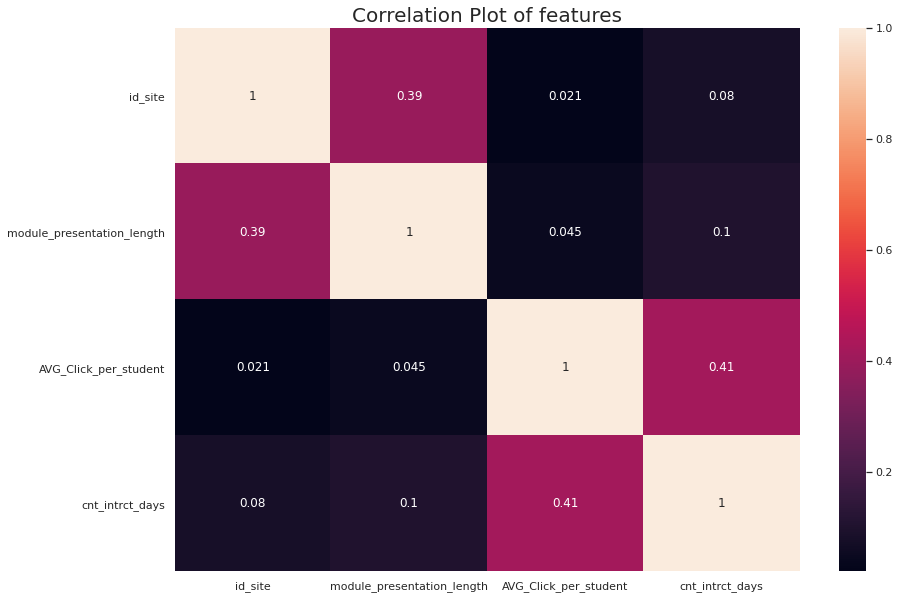

In [71]:
# Create a correlation matrix
_ = plt.figure(figsize=(14,10))
_ = sns.heatmap(vle_final.corr(),annot=True)
plt.title('Correlation Plot of features', fontsize = 20)

In [72]:
#dropping highly correlated variables
corr_matrix_vle = vle_final.corr().abs()

# Creating a mask to filter only one instance of the correlation
upper_tri_vle = corr_matrix_vle.where(np.triu(np.ones(corr_matrix_vle.shape),k=1).astype(np.bool))

#list features with correlation higher than 0.4
to_drop = [column for column in upper_tri_vle.columns if any(upper_tri_vle[column] > 0.4)]
print(); print(to_drop)


['cnt_intrct_days']


In [73]:
#drop the columns with correlation higher than 0.4
vle_final = vle_final.drop(vle_final[to_drop], axis=1)
vle_final.head()

,id_site,activity_type,module_presentation_length,mod_presentation,AVG_Click_per_student,Module_Session
0,546943,resource,268,AAA-2013J,1.333333,J
1,546712,oucontent,268,AAA-2013J,6.057471,J
2,546998,resource,268,AAA-2013J,1.500000,J
3,546888,url,268,AAA-2013J,1.363636,J
4,547035,resource,268,AAA-2013J,1.473684,J


<h3 align="center">VLE_FINAL table spec</h3> 


| Final Table Name | Column | Description |soure table |
| --- | --- | --- | --- |
| vle_final | id_site | .843 |vle |
| vle_final | activity_type | .843 |vle |
| vle_final | module_presentation_length | .843 |Courses |
| vle_final | mod_presentation | .843 |Derived Values |
| vle_final | AVG_Click_per_student | .843 |Calculated from studentVle |
| vle_final | Module_Session | .843 |Derived values |

### 2.2.3  Table 3: Creating a single source of truth for all course related information. 
We will be creating a table which at an instance level hold details of each code presentation and the code module that was registered for in this database. The table will include course registrations information, vle activities and student registration details.

In [74]:
#create a copy of the original courses table
courses_final = courses.copy()

#### Creating features related to course registrations.
We got the total number of students that registered or unregistered for a particular course.

In [75]:
#number of registered students
count_reg = studentReg.groupby(["code_module","code_presentation"]).\
count()['date_registration'].reset_index()

#rename the column
count_reg = count_reg.rename(columns={"date_registration": "count_reg"})

#joining with the courses final table
courses_final = pd.merge(courses_final,count_reg,how="inner",on=\
                          ["code_module","code_presentation"])

In [76]:
#number of unregistered students
count_unreg = studentReg.groupby(["code_module","code_presentation"]).\
count()['date_unregistration'].reset_index()

#rename the column
count_unreg = count_unreg.rename(columns={"date_unregistration": "count_unreg"})

#joining with the courses final table
courses_final = pd.merge(courses_final,count_unreg,how="inner",on=\
                          ["code_module","code_presentation"])

#### Creating features related to vle activities for each course.
We got the average click per student on all the vle resources related to a particular course.

In [77]:
#average click per student
#-----------------------------
#get the total number of students click per course resources on vle
avg_click_temp = studentVle.groupby(["code_module","code_presentation",'id_student']).\
sum()["sum_click"].reset_index()
#average click on for the vle resources on a course.
avg_click_temp = avg_click_temp.groupby(["code_module","code_presentation"]).\
mean()["sum_click"].reset_index()
#rename the column
avg_click = avg_click_temp.rename(columns={"sum_click": "avg_click_stud"})

#joining with the courses final table
courses_final = pd.merge(courses_final,avg_click,how="inner",on=\
                          ["code_module","code_presentation"])

#### Creating features related to student registration activities for each course.
We were able to get the number of students that were classified as withdrawn from each course. We also got the total count of students that passed each course and the pass rate. The total number of students that failed a course and the course fail rate was added and the same was done for distinction rate and count for each course. This dataset will be used for a clustering analysis to see if we have groups among the different course types.

In [78]:
#student withdrawal only from the student info table
withdrawn_cnt = studentInfo[studentInfo['final_result'] == 'Withdrawn']
#group the withdrawal by code module and code presentation
withdrawn_cnt = withdrawn_cnt.groupby(['code_module','code_presentation']).count()['id_student'].reset_index()

#rename the column
withdrawn_cnt = withdrawn_cnt.rename(columns={"id_student": "withdrawn_cnt"})

#get percentage withdrawal of students
withdrawn_cnt['withdrawn_rate'] = (withdrawn_cnt["withdrawn_cnt"]/courses_final['count_reg']) * 100
#joining with the courses final table
courses_final = pd.merge(courses_final,withdrawn_cnt,how="inner",on=\
                          ["code_module","code_presentation"])

In [79]:
#getting pass rate and count
Pass_cnt = studentInfo[studentInfo['final_result'] == 'Pass']
Pass_cnt = Pass_cnt.groupby(['code_module','code_presentation']).count()['id_student'].reset_index()

#rename the column
Pass_cnt = Pass_cnt.rename(columns={"id_student": "Pass_cnt"})

#get percentage withdrawal of students
Pass_cnt['Pass_rate'] = (Pass_cnt["Pass_cnt"]/courses_final['count_reg']) * 100

#joining with the courses final table
courses_final = pd.merge(courses_final,Pass_cnt,how="inner",on=\
                          ["code_module","code_presentation"])

In [80]:
#getting distinction rate and count
Distinction_cnt = studentInfo[studentInfo['final_result'] == 'Distinction']
Distinction_cnt = Distinction_cnt.groupby(['code_module','code_presentation']).count()['id_student'].reset_index()


#rename the column
Distinction_cnt = Distinction_cnt.rename(columns={"id_student": "Distinction_cnt"})

#get percentage withdrawal of students
Distinction_cnt['Distinction_rate'] = (Distinction_cnt["Distinction_cnt"]/courses_final['count_reg']) * 100

#joining with the courses final table
courses_final = pd.merge(courses_final,Distinction_cnt,how="inner",on=\
                          ["code_module","code_presentation"])

In [81]:
#getting Fail rate and count
Fail_cnt = studentInfo[studentInfo['final_result'] == 'Fail']
Fail_cnt = Fail_cnt.groupby(['code_module','code_presentation']).count()['id_student'].reset_index()

#rename the column
Fail_cnt = Fail_cnt.rename(columns={"id_student": "Fail_cnt"})

#get percentage withdrawal of students
Fail_cnt['Fail_rate'] = (Fail_cnt["Fail_cnt"]/courses_final['count_reg']) * 100

#joining with the courses final table
courses_final = pd.merge(courses_final,Fail_cnt,how="inner",on=\
                          ["code_module","code_presentation"])

In [82]:
courses_final.head()

,code_module,code_presentation,module_presentation_length,mod_presentation,count_reg,count_unreg,avg_click_stud,withdrawn_cnt,withdrawn_rate,Pass_cnt,Pass_rate,Distinction_cnt,Distinction_rate,Fail_cnt,Fail_rate
0,AAA,2013J,268,AAA-2013J,383,60,1715.592593,60,15.665796,258,67.362924,20,5.221932,45,11.749347
1,AAA,2014J,269,AAA-2014J,365,66,1675.512605,66,18.082192,229,62.739726,24,6.575342,46,12.602740
2,BBB,2013J,268,BBB-2013J,2235,647,737.249198,644,28.109996,896,39.109559,176,7.682235,521,22.741161
3,BBB,2014J,262,BBB-2014J,2291,736,871.287871,749,46.579602,972,60.447761,180,11.194030,391,24.315920
4,BBB,2013B,240,BBB-2013B,1766,505,876.975277,505,22.595078,648,28.993289,155,6.935123,459,20.536913


#### Removing redundant features
We will be removing the following features ['code_module','code_presentation','count_reg','count_unreg','count_unreg','withdrawn_cnt','Pass_cnt','Distinction_cnt','Fail_cnt'] since they are offer redundancy to our dataset. The course information is handled by the extracted mod_presentation and the final result rates will mean the count of each final result count is redundant since we have the rates for each course. 

In [83]:
#dropping code_module and code_presentation and all final result counts
courses_final = courses_final.drop(['code_module','code_presentation','count_reg','count_unreg',\
                                   'withdrawn_cnt','Pass_cnt','Distinction_cnt','Fail_cnt'],axis=1)

In [84]:
courses_final.head()

,module_presentation_length,mod_presentation,avg_click_stud,withdrawn_rate,Pass_rate,Distinction_rate,Fail_rate
0,268,AAA-2013J,1715.592593,15.665796,67.362924,5.221932,11.749347
1,269,AAA-2014J,1675.512605,18.082192,62.739726,6.575342,12.602740
2,268,BBB-2013J,737.249198,28.109996,39.109559,7.682235,22.741161
3,262,BBB-2014J,871.287871,46.579602,60.447761,11.194030,24.315920
4,240,BBB-2013B,876.975277,22.595078,28.993289,6.935123,20.536913


In [85]:
#checking for null values
courses_final.isnull().sum()

module_presentation_length    0
mod_presentation              0
avg_click_stud                0
withdrawn_rate                0
Pass_rate                     0
Distinction_rate              0
Fail_rate                     0
dtype: int64

##### Filtering out highly correlated features

<AxesSubplot:>

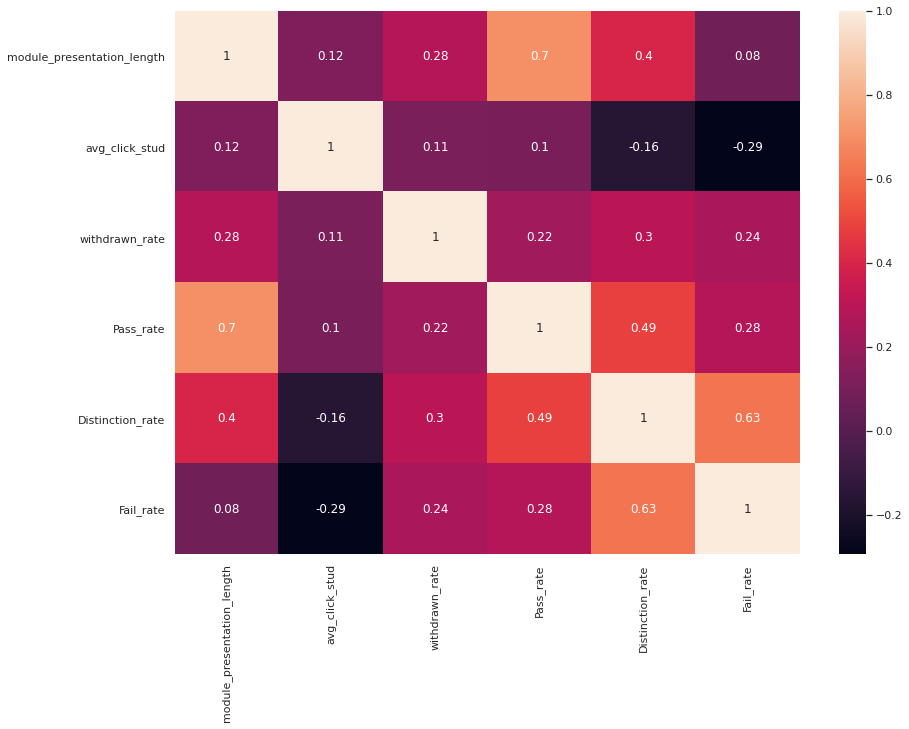

In [86]:
# Create a correlation matrix
plt.figure(figsize=(14,10))
sns.heatmap(courses_final.corr(),annot=True)


In [87]:
#dropping highly correlated variables
corr_matrix_courses = courses_final.corr().abs()

# Creating a mask to filter only one instance of the correlation
upper_tri_courses = corr_matrix_courses.where(np.triu(np.ones(corr_matrix_courses.shape),k=1).astype(np.bool))

#list features with correlation higher than 0.4
to_drop = [column for column in upper_tri_courses.columns if any(upper_tri_courses[column] > 0.4)]
print(); print(to_drop)


['Pass_rate', 'Distinction_rate', 'Fail_rate']


In [88]:
#drop the columns
courses_final = courses_final.drop(courses_final[to_drop], axis=1)

In [89]:
courses_final.head()

,module_presentation_length,mod_presentation,avg_click_stud,withdrawn_rate
0,268,AAA-2013J,1715.592593,15.665796
1,269,AAA-2014J,1675.512605,18.082192
2,268,BBB-2013J,737.249198,28.109996
3,262,BBB-2014J,871.287871,46.579602
4,240,BBB-2013B,876.975277,22.595078


<h3 align="center">courses_final table spec</h3> 


| Final Table Name | Column  |soure table |
| --- | --- | --- |
| courses_final | module_presentation_length |Courses |
| courses_final | mod_presentation  |Extracted feature |
| courses_final | avg_click_stud  |Extracted feature from studentVle |
| courses_final | withdrawn_cnt  |Extracted feature from studentInfo |

We have completed the preprocessing and created summary tables for the different units in the database. We will be using feature engineering and selection techniques to create features that will be in the final model used for the different Machine learning tasks to be performed.

This concludes the first stage of this task which involves preprocessing, exploration and feature engineering. We will commence the next step by implementing machine learning algorithms on the features we have created in this stage.

## 2.4.0   Task B: Unsupervised analysis

<img src="unsups.gif">

We have a collection of dataset for student information, vle activities and course details, we will explore this dataset and try to uncover patterns within the different sets. We will be employing tools such as dimensionality reduction and other tools for this section. We will be using 4 different clustering techniques. Two distance based clustering and two density based clustering methods.
* KMeans Clustering
* Hierarchical Clustering
* Mean-shift clustering
* DBSCAN - Density-Based Spatial Clustering of Applications with Noise

### 2.4.1   Unsupervised analysis  on student information

##### Exploring the dataset
We checked for null values, shape of the dataframe and information of the features in the std_info_final_copy table. This table holds information about the students activities, scores and demography. 

In [90]:
std_info_final_copy.shape

(24789, 18)

In [91]:
std_info_final_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24789 entries, 0 to 25789
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   gender                      24789 non-null  object 
 1   region                      24789 non-null  object 
 2   highest_education           24789 non-null  object 
 3   age_band                    24789 non-null  object 
 4   num_of_prev_attempts        24789 non-null  int64  
 5   studied_credits             24789 non-null  int64  
 6   disability                  24789 non-null  object 
 7   mod_presentation            24789 non-null  object 
 8   ast_weighted_grade          24789 non-null  float64
 9   Exam_score                  24789 non-null  float64
 10  sum_click                   24789 non-null  int64  
 11  avg_daily_click             24789 non-null  float64
 12  Distinct_intrct_days        24789 non-null  int64  
 13  date_registration           247

In [92]:
std_info_final_copy.isnull().sum()

gender                        0
region                        0
highest_education             0
age_band                      0
num_of_prev_attempts          0
studied_credits               0
disability                    0
mod_presentation              0
ast_weighted_grade            0
Exam_score                    0
sum_click                     0
avg_daily_click               0
Distinct_intrct_days          0
date_registration             0
Module_Session                0
module_presentation_length    0
imd_band_Deprivity            0
final_result_calc             0
dtype: int64

##### Creating a new dataframe 
We created a copy of the original dataset, so we can perform the cluster analysis and other exploratory tasks to uncover hidden trends in the data.

In [93]:
#create a new variable to hold the data for clustering
cl_stud_info = std_info_final_copy.copy()

In [94]:
cl_stud_info.head()

,gender,region,highest_education,age_band,num_of_prev_attempts,studied_credits,disability,mod_presentation,ast_weighted_grade,Exam_score,sum_click,avg_daily_click,Distinct_intrct_days,date_registration,Module_Session,module_presentation_length,imd_band_Deprivity,final_result_calc
0,M,East Anglian Region,HE Qualification,55<=,0,240,N,AAA-2013J,82.4,0.0,934,4.765306,40,-159.0,J,268,Non-Deprived,Pass
1,F,Scotland,HE Qualification,35-55,0,60,N,AAA-2013J,65.4,0.0,1435,3.337209,80,-53.0,J,268,Deprived,Pass
2,F,South East Region,A Level or Equivalent,35-55,0,60,N,AAA-2013J,76.3,0.0,2158,3.254902,123,-52.0,J,268,Non-Deprived,Pass
3,F,West Midlands Region,Lower Than A Level,0-35,0,60,N,AAA-2013J,55.0,0.0,1034,2.937500,70,-176.0,J,268,Non-Deprived,Pass
4,M,Wales,A Level or Equivalent,35-55,0,60,N,AAA-2013J,66.9,0.0,2445,3.381743,143,-110.0,J,268,Non-Deprived,Pass


##### Label Encoding the dataset
All non-numeric features were encoded using the LabelEncoder function of the sklearn.preprocessing class.

In [95]:
#encoding all non numeric columns
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()

#converting all object features to numeric
for i in cl_stud_info.select_dtypes(include=['object']):
    cl_stud_info[i]= lab_enc.fit_transform(cl_stud_info[i].astype('str'))


##### Standardizing the data
We used StandardScaler function from sklearn.preprocessing library to standardize the dataset.

In [96]:
#standardizing the data
# Import the StandardScaler
from sklearn.preprocessing  import StandardScaler

# Scale the features and set the values to a new variable
scaler = StandardScaler()
cl_stud_info = scaler.fit_transform(cl_stud_info)
#converting back
#we get the selected features by converting arrays back to df
columns_data_stud = std_info_final_copy.columns.values
cl_stud_info = pd.DataFrame(cl_stud_info, columns=columns_data_stud)
#we now have three data stud_y,stud_X and stud_X_scaled

##### Checking for correlation
We checked the new dataframe for correlated features, we will be using a dimensionality reduction technique, Principal Component Analysis to handle correlation among features. We observe correlation coefficient greater than 0.4 for features like sum_click,avg_daily_click,Distinct_intrct_days and module_presentation_length.

In [97]:
#get features and their correlated features into a matrix
upper_tri = cl_stud_info.corr().abs().where(np.triu(np.ones(cl_stud_info.corr().abs().shape),k=1).astype(np.bool))

#retrieve features with correlation value greater than 0.4
high_corr = [column for column in upper_tri.columns if any(upper_tri[column] > 0.4)]

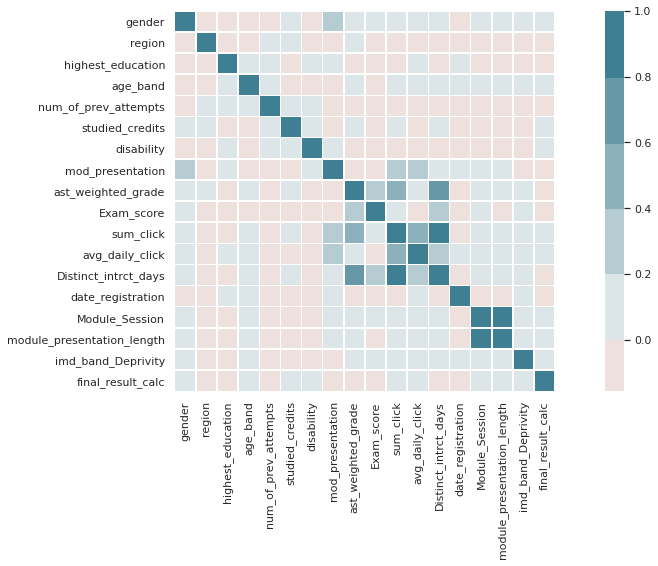

In [98]:
#check correlation of features in cl_stud_info
corr = cl_stud_info.corr()
cor_mat = sns.heatmap(
    corr,
  center = 0,
    cmap = sns.diverging_palette(20,220, n = 10),
    square = True,
    linewidths = 0.5
)

### Principal Component Analysis on the student information table

<p>We used the Principal component analysis technique to reduce the dimension of the dataset to components that explain 90% of variability in the data. <strong>scree-plots</strong> and <strong>cumulative explained ratio plots</strong> we used to find the number of components.</p>


<p>We used the Scree-plots to display the number of components against the variance explained by each component, sorted in descending order of variance. This gives a visual representation of the variance explained by each component and using the elbow method which used the point of steep drop in the data as the cutoff point for the appropriate amount of components.</p>

In [99]:
#importing pca package
from sklearn.decomposition import PCA
# Get our explained variance ratios from PCA using all features
pca = PCA(n_components = 0.90,random_state=2021)
ex_pca_std = pca.fit_transform(cl_stud_info)

In [100]:
print('Number of components accounting for 95% of variance is ' + str(pca.n_components_))

Number of components accounting for 95% of variance is 13


##### Plotting explained variance

Text(0.5, 1.0, 'Scree Plot')

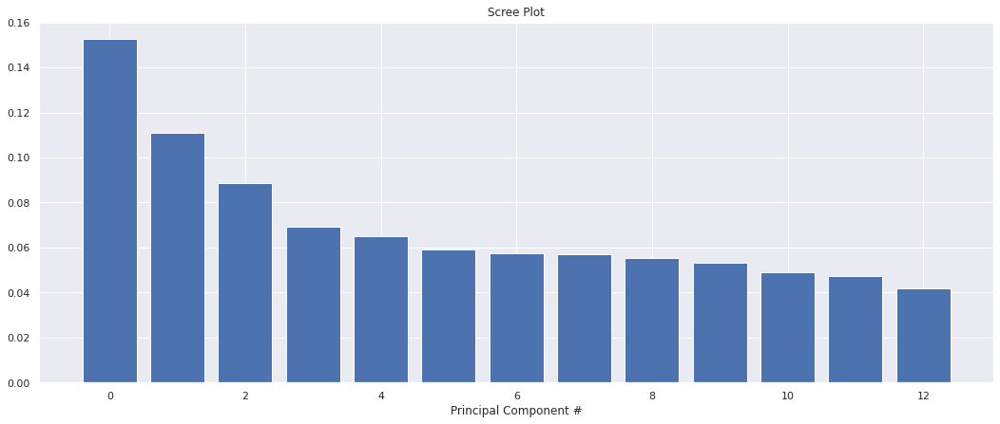

In [101]:
#variance explained by each component
ex_pca_std_var = pca.explained_variance_ratio_
#number of components
ex_pca_std_ncomp = pca.n_components_
# plot the explained variance using a barplot
fig, ax = plt.subplots()
ax.bar(range(ex_pca_std_ncomp), ex_pca_std_var)
ax.set_xlabel('Principal Component #')
ax.set_title('Scree Plot')

##### Plotting cumulative variance
<p>We will be selecting features that explains about 85% of the variance in the dataset. Once we determine the appropriate number of components, we can perform PCA with that many components, ideally reducing the dimensionality of our data.</p>

Text(0.5, 1.0, 'Cummulative variance Plot')

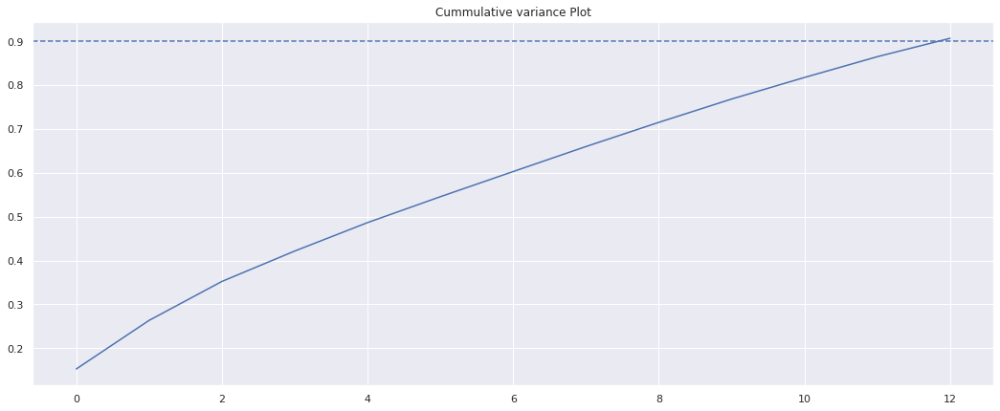

In [102]:
import numpy as np

# Calculate the cumulative explained variance
ex_pca_std_cum = np.cumsum(ex_pca_std_var)

# Plot the cumulative explained variance and draw a dashed line at 0.85.
fig, ax = plt.subplots()
ax.plot(ex_pca_std_cum)
#components explaining 90% of variance in the data
ax.axhline(y=0.90, linestyle='--')
ax.set_title('Cummulative variance Plot')

##### Create pca projections dataframe
Converting the principal component projections into a dataframe.

In [103]:
#convert projections to dataframe
ex_pca_std = pd.DataFrame(ex_pca_std, columns = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10',\
                                         'PC11','PC12','PC13'])
ex_pca_std.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13
0,1.116728,-0.446990,-1.778475,1.803522,2.027344,-1.330972,2.683491,-1.493939,-0.268853,1.551243,-0.134960,0.618711,-4.332941
1,0.129392,-0.709950,-1.209129,-0.812666,2.111017,0.250914,-0.797881,-0.379707,-0.532501,0.216254,-0.552892,0.592472,-0.385747
2,1.138890,-0.367393,-1.733791,-1.275621,1.561675,-0.180060,-0.080421,-1.174062,-1.131338,-0.343895,0.740339,0.290690,-0.274330
3,-0.260244,-0.898894,-1.781410,-0.259636,1.026958,-0.614165,-0.891817,-0.663374,1.682086,0.772988,1.786663,-1.517229,0.107335
4,1.783213,-0.429587,-1.510198,-0.678293,0.618300,-0.658439,0.027773,-1.312484,0.499038,-0.420689,1.008536,0.867976,-0.942578


### Scatter plot of the student final results
The scatterplot for the principal components of the Student Information table was plotted to give a view of the distribution of the datapoints in a dataspace.

In [104]:
#creating dataframe of principal projections
pca_projections_source = ex_pca_std.join(std_info_final_copy)

In [105]:
#creating different dataframes for the different final result classes
Pass = pca_projections_source[pca_projections_source['final_result_calc'] == 'Pass']
Fail = pca_projections_source[pca_projections_source['final_result_calc'] == 'Fail']
Withdrawn = pca_projections_source[pca_projections_source['final_result_calc'] == 'Withdrawn']

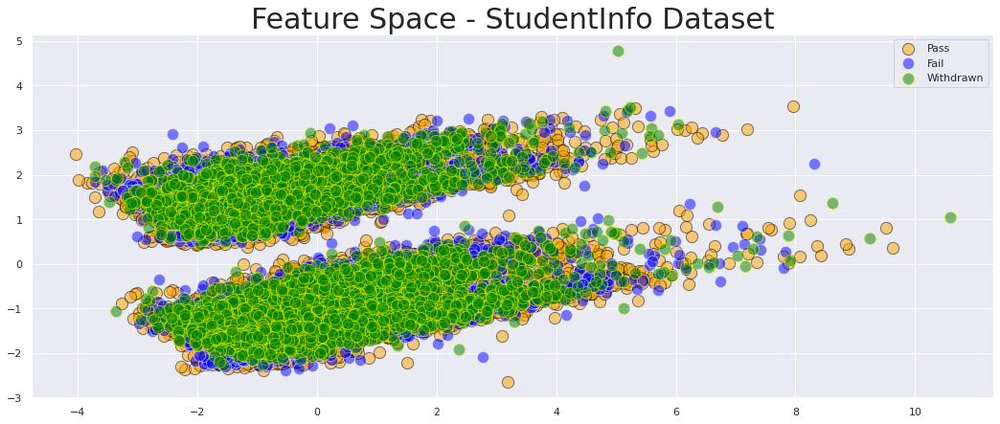

In [106]:
# Make a scatter plot of pca1 and pca1 coloring by the final result class
plt.scatter(Pass['PC1'],Pass['PC2'],c = 'orange', label = 'Pass', s=150,alpha=0.5,edgecolors='black')
plt.scatter(Fail['PC1'],Fail['PC2'],c = 'blue', label = 'Fail',s=150,alpha=0.5,edgecolors='white')
plt.scatter(Withdrawn['PC1'],Withdrawn['PC2'],c = 'green', label = 'Withdrawn',s=150,alpha=0.5,edgecolors='yellow')
plt.title('Feature Space - StudentInfo Dataset',fontsize = 30)
plt.legend()
plt.show()

In [107]:
#making a interactive 3d plot of the feature space
labels =  std_info_final_copy['final_result_calc'].astype(str)
df = pca_projections_source
fig = px.scatter_3d(df, x='PC1', y='PC2', z='PC3',
              color=labels)
#adding title and labels
fig.update_layout(
    title="3D Feature Space - StudentInfo Dataset",
    legend_title="Final Class",
    font=dict(
        family="Courier New, monospace",
        color="RebeccaPurple"
    )
)

fig.show()

### Exploring the data with Tsne plot 

We will be using the t-distributed Stochastic Neighbor Embedding to visualize our data and see patterns in our high dimension dataset. We colored the data space using the final result class and we observe that we have different patches of the classes scattered all around the space. Using a vertical line to split the data space we observe that we do have two different groups in the dataset with the different final result classses scattered around both groups.

In [108]:
from sklearn.manifold import TSNE
m = TSNE(learning_rate=150,random_state=200)

In [109]:
tsne_stud = cl_stud_info['final_result_calc']

In [110]:
tsne_features_WF = m.fit_transform(cl_stud_info)

In [111]:
tsne_maps_WF = std_info_final_copy.copy()
tsne_maps_WF['x'] = tsne_features_WF[:,0]
tsne_maps_WF['y'] = tsne_features_WF[:,1]

<AxesSubplot:xlabel='x', ylabel='y'>

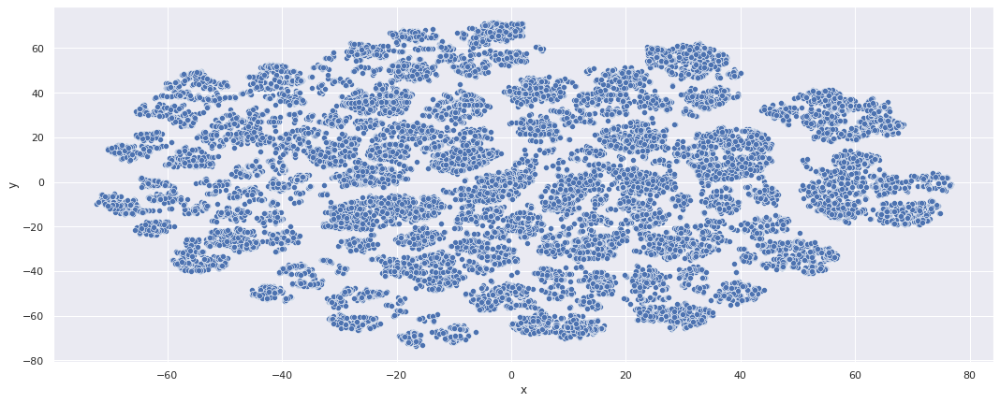

In [112]:
sns.scatterplot(x="x", y="y", data=tsne_maps_WF)

<AxesSubplot:xlabel='x', ylabel='y'>

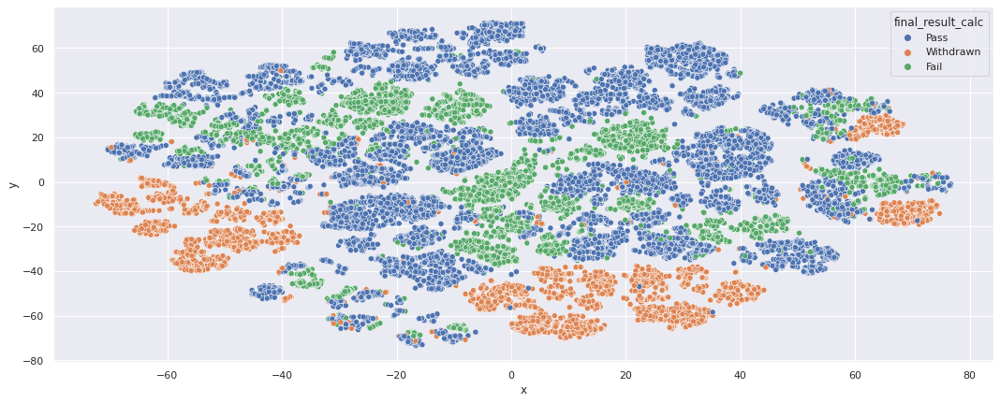

In [113]:
#scatter plot of the T-SNE by final result
sns.scatterplot(x="x", y="y",hue='final_result_calc', data=tsne_maps_WF)
#plot straight line
#plt.axvline(-10,linewidth=4)

### Kmeans Algorithm

**The Elbow Method to find the No. of Optimal Clusters**
We used the elbow method to evaluate the optimal number of clusters for the dataset. We need number of clusters that gives tight clusters(low inertia) and not too many clusters, this is where we introduce the elbow method on the inertia vs count of clusters plot. The point where the inertia begins decreasing slowly will be the elbow of the plot and will be equal to the number of clusters to be used.

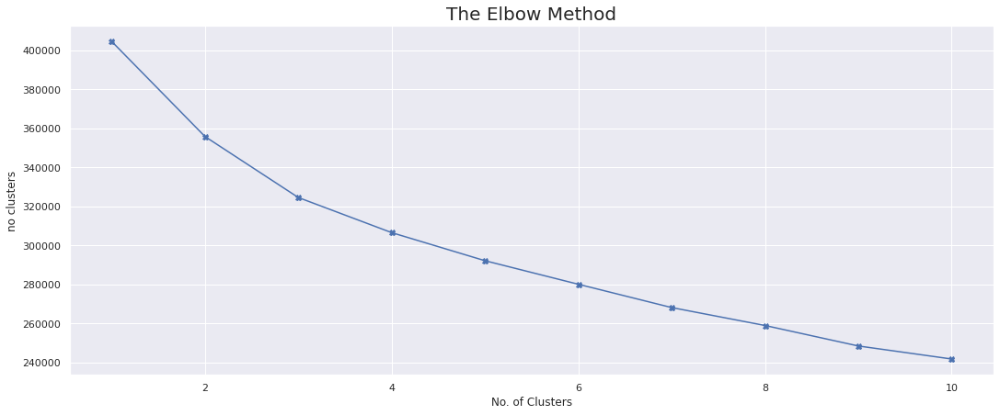

In [114]:
#importing the KMeans package
from sklearn.cluster import KMeans

#initiate an empty list to hold number of clusters
no_cluster = []
#loop through within a range of 1 to 11 and append inertias for each loop to the empty list
for i in range(1, 11):
    km = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    km.fit(ex_pca_std)
    no_cluster.append(km.inertia_)
    
plt.plot(range(1, 11), no_cluster,marker = 'X')
plt.title('The Elbow Method', fontsize = 20)
plt.xlabel('No. of Clusters')
plt.ylabel('no clusters')
plt.show()

The plot above shows that we have two breaking points between 2 clusters and 4. We will be choosing 3 clusters as the number of clusters in the datset since optimal clusters is between 2 and 4 and we need the lowest number of clusters.

##### Fitting the KMeans Model

In [115]:
#running KMeans algorithm with 3 clusters
km = KMeans(n_clusters = 3, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
#using the fit predict method to predict the clusters each feature belongs to
km_labels_stud = km.fit_predict(ex_pca_std.values)

###### Grouping the datapoints by their KMeans cluster label
We grouped each datapoint in the data by the KMeans cluster they belong to, cluster 1, cluster 2 and cluster 3.

In [116]:
#join principal component projections with the Kmeans labels
pca_projections_km = ex_pca_std.join(pd.DataFrame(km_labels_stud,columns=['cluster']))
cluster1_km = pca_projections_km[pca_projections_km['cluster'] == 0]
cluster2_km = pca_projections_km[pca_projections_km['cluster'] == 1]
cluster3_km = pca_projections_km[pca_projections_km['cluster'] == 2]

##### Plotting the datapoints and color by cluster

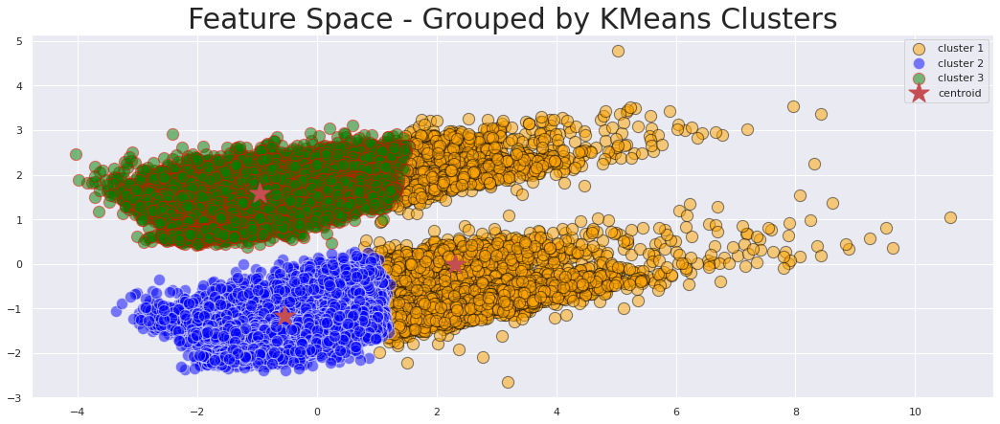

In [117]:
# Make a scatter plot of xs and ys, using labels_stud to define the colors
plt.scatter(cluster1_km['PC1'],cluster1_km['PC2'],c = 'orange', label = 'cluster 1', s=150,alpha=0.5,edgecolors='black')
plt.scatter(cluster2_km['PC1'],cluster2_km['PC2'],c = 'blue', label = 'cluster 2',s=150,alpha=0.5,edgecolors='white')
plt.scatter(cluster3_km['PC1'],cluster3_km['PC2'],c = 'green', label = 'cluster 3',s=150,alpha=0.5,edgecolors='red')
plt.title('Feature Space - Grouped by KMeans Clusters',fontsize = 30)
plt.legend()
# Assign the cluster centers: centroids
centroids = km.cluster_centers_

# Assign the columns of centroids: centroids_x, centroids_y
centroids_x = centroids[:,0]
centroids_y = centroids[:,1]


# Make a scatter plot of centroids_x and centroids_y
plt.scatter(centroids_x,centroids_y,marker="*",s=500, label = 'centroid', c='r')
plt.legend()
plt.show()

In [118]:
labels =  km_labels_stud.astype(str)
fig = px.scatter_3d(pca_projections_source, x='PC1', y='PC2', z='PC3',
              color=labels)
#adding title and labels
fig.update_layout(
    title="3D Feature Space - Grouped by KMeans Clusters",
    legend_title="Final Class",
    font=dict(
        family="Courier New, monospace",
        color="RebeccaPurple"
    )
)

fig.show()

### Hierarchial Clustering Algorithm

In this method of clustering we will build hierarchies by grouping datapoints into similar groups. The endpoint of the process will be a set of clusters in which each datapoint is similar to other datapoints in the same cluster. Based on the Elbow method we are going to proceed with using 3 clusters for our hierarchical clustering. We will be using the euclidean distance between datapoints and apply the ward linkage method.


##### Fitting the Hierarchical Algorithm

In [119]:
#import the AgglomerativeClustering package
from sklearn.cluster import AgglomerativeClustering
#create an object of the class with number of clusters, affinity and the linkage
agglo_model = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage = 'ward')
hc_label_stud = agglo_model.fit_predict(ex_pca_std.values)

##### Grouping the datapoints by their Hierarchial cluster label

In [120]:
#add cluster label to the datapoints
pca_projections_hc = ex_pca_std.join(pd.DataFrame(hc_label_stud,columns=['cluster']))
cluster1_hc = pca_projections_hc[pca_projections_hc['cluster'] == 0]
cluster2_hc = pca_projections_hc[pca_projections_hc['cluster'] == 1]
cluster3_hc = pca_projections_hc[pca_projections_hc['cluster'] == 2]

##### Scatterplot of datapoints group by hierarchical labels

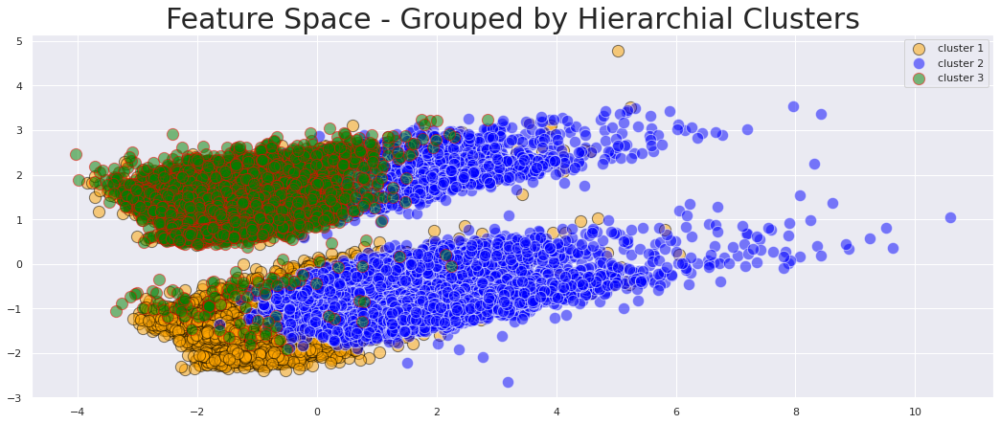

In [121]:
# Make a scatter plot of xs and ys, using labels_stud to define the colors
plt.scatter(cluster1_hc['PC1'],cluster1_hc['PC2'],c = 'orange', label = 'cluster 1', s=150,alpha=0.5,edgecolors='black')
plt.scatter(cluster2_hc['PC1'],cluster2_hc['PC2'],c = 'blue', label = 'cluster 2',s=150,alpha=0.5,edgecolors='white')
plt.scatter(cluster3_hc['PC1'],cluster3_hc['PC2'],c = 'green', label = 'cluster 3',s=150,alpha=0.5,edgecolors='red')
plt.title('Feature Space - Grouped by Hierarchial Clusters',fontsize = 30)

plt.legend()


plt.show()

In [122]:
labels =  hc_label_stud.astype(str)
fig = px.scatter_3d(pca_projections_source, x='PC1', y='PC2', z='PC3',
              color=labels)
#adding title and labels
fig.update_layout(
    title="3D Feature Space -Grouped by Hierarchial Clusters",
    legend_title="Final Class",
    font=dict(
        family="Courier New, monospace",
        color="RebeccaPurple"
    )
)

fig.show()

### Meanshift Clustering Algorithm

Unlike the previous methods used above which uses distances between datapoints, the mean-shift algorithm assigns each datapoint to a cluster by measuring the density of the datapoints within its data space. We will not be specifying the number of clusters here rather we select the bandwidth of each datapoint.

##### Fitting the MeanShift Algorthm

In [123]:
#Applying the mean shift algorithm
from sklearn.cluster import MeanShift
mshift = MeanShift(bandwidth=0.4)
mshift.fit(ex_pca_std)
pred_mshift_stud = mshift.predict(ex_pca_std)

##### Scatterplot of the datapoints

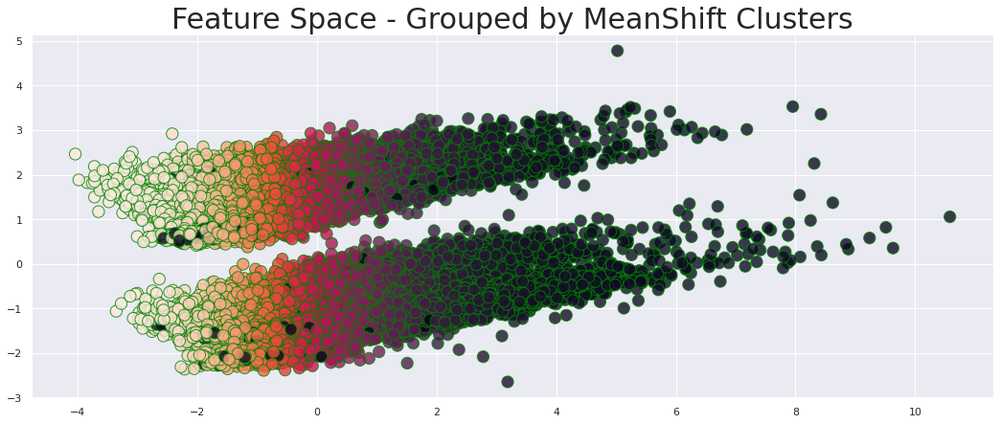

In [124]:
# Make a scatter ex_pca of xs and ys, using labels_stud to define the colors
plt.scatter(ex_pca_std['PC1'],ex_pca_std['PC2'],c = pred_mshift_stud ,alpha=0.8,edgecolors='green',s=150 )
plt.title('Feature Space - Grouped by MeanShift Clusters',fontsize = 30)
plt.show()

In [125]:
fig = px.scatter_3d(pca_projections_source, x='PC1', y='PC2', z='PC3',
              color=pred_mshift_stud)
#adding title and labels
fig.update_layout(
    title="3D Feature Space -Grouped by MeanShift Clusters",
    legend_title="Final Class",
    font=dict(
        family="Courier New, monospace",
        color="RebeccaPurple"
    )
)

fig.show()

### DBSCAN Clustering Algorithm

The density-based spatial clustering of applications with noise (DBSCAN) algorithm like it name shows is also a density based clustering algorithm which groups close points as neighbors and further away points are marked as outliers. We will also not select number of clusters for this algorithm rather we will select the epsilon which is the maximum distance that defines the radius within which the algorithm searches for neighbors. We selected 0.8 as the radius since we want close groups.

In [126]:
#Applying the dbscan  algorithm
from sklearn.cluster import DBSCAN
est_dbscan = DBSCAN(eps=0.8)
pred_dbscan_stud = est_dbscan.fit_predict(ex_pca_std)

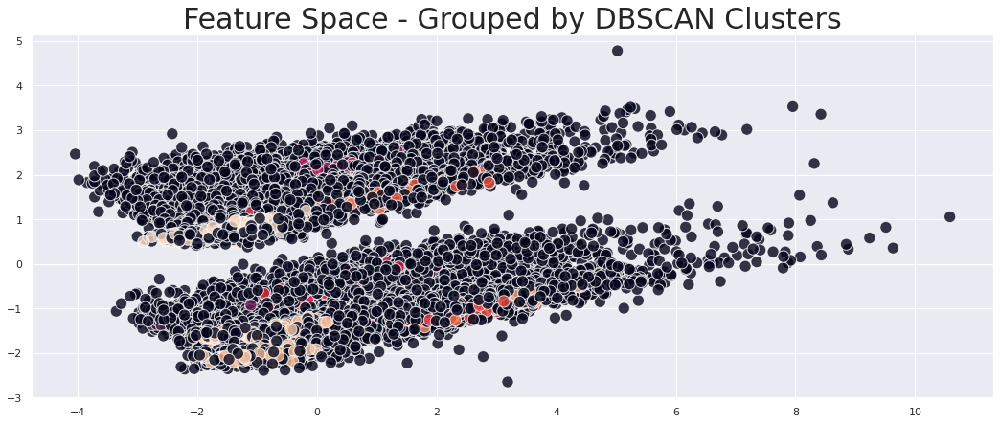

In [127]:

# Make a scatter plot of xs and ys, using labels to define the colors
plt.scatter(ex_pca_std['PC1'],ex_pca_std['PC2'], c=pred_dbscan_stud, alpha=0.8,edgecolors='white',s=150)
plt.title('Feature Space - Grouped by DBSCAN Clusters',fontsize = 30)
plt.show()


In [128]:
fig = px.scatter_3d(pca_projections_source, x='PC1', y='PC2', z='PC3',
              color=pred_dbscan_stud)
#adding title and labels
fig.update_layout(
    title="3D Feature Space -Grouped by DBSCAN Clusters",
    legend_title="Final Class",
    font=dict(
        family="Courier New, monospace",
        color="RebeccaPurple"
    )
)

fig.show()

## Measuring and Comparing the Performance of the Algorithms

#### Cross Tabulating KMEANS

In [129]:
final_res_labels = std_info_final_copy['final_result_calc']
km_ct_temp = ex_pca_std.join(pd.DataFrame(km_labels_stud))
km_ct_temp = km_ct_temp.join(pd.DataFrame(final_res_labels))
km_ct_temp = km_ct_temp.rename(index=str, columns={0:'cluster'})
km_ct = pd.crosstab(km_ct_temp['cluster'],km_ct_temp['final_result_calc'])

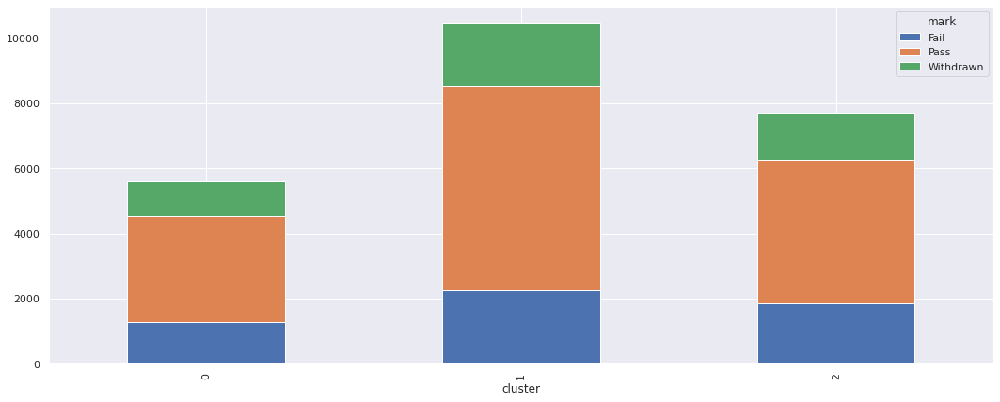

In [130]:
#plotting the crosstab
km_ct.plot.bar(stacked=True)
plt.legend(title='mark')

plt.show()

#### Cross Tabulating Hierarchial

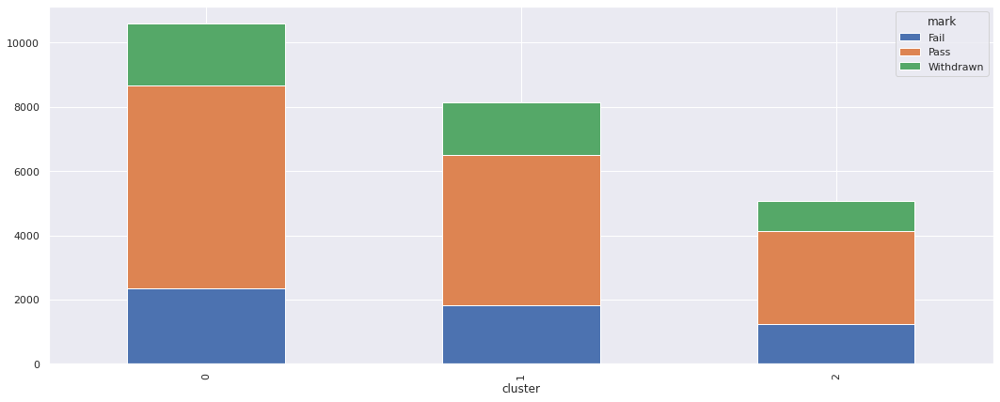

In [131]:
hc_ct_temp = ex_pca_std.join(pd.DataFrame(hc_label_stud))
hc_ct_temp = hc_ct_temp.join(pd.DataFrame(final_res_labels))
hc_ct_temp = hc_ct_temp.rename(index=str, columns={0:'cluster'})
hc_ct = pd.crosstab(hc_ct_temp['cluster'],hc_ct_temp['final_result_calc'])
#Kmeans crosstab
#plotting the crosstab
hc_ct.plot.bar(stacked=True)
plt.legend(title='mark')

plt.show()

#### Cross Tabulating Meanshift 

In [132]:
mean_ct_temp = ex_pca_std.join(pd.DataFrame(pred_mshift_stud))
mean_ct_temp = mean_ct_temp.join(pd.DataFrame(final_res_labels))
mean_ct_temp = mean_ct_temp.rename(index=str, columns={0:'cluster'})
mean_ct = pd.crosstab(mean_ct_temp['cluster'],mean_ct_temp['final_result_calc']).reset_index()

#### Cross Tabulating DBSCAN 

In [133]:
dbscan_ct_temp = ex_pca_std.join(pd.DataFrame(pred_dbscan_stud))
dbscan_ct_temp = dbscan_ct_temp.join(pd.DataFrame(final_res_labels))
dbscan_ct_temp = dbscan_ct_temp.rename(index=str, columns={0:'cluster'})
dbscan_ct = pd.crosstab(dbscan_ct_temp['cluster'],dbscan_ct_temp['final_result_calc']).reset_index()

#### Numerical Evaluation of Algorithms
The silhoutte_score and Calinski–Harabasz Index  to evaluate the clusters:
* <strong> silhoutte_score</strong>: This is an evaluation technique that calculates the average distance between a data point and all other data points of its nearesr cluster. We obtain a value between -1 and 1. The higher the silhoutte score the bettwe the performance of the algorithm. <br/>
s = (b - a) / max(a,b)
* <strong>Calinski–Harabasz Index</strong> : This performance metric measures the relationship between the variance of each cluster and the variance of all clusters. The variance of each cluster is the mean square error of each pointwith respect to the cluster centroid, while variance of all clusters refer to the overall inter-cluster variance. We need a high value for the Calinski–Harabasz Index since this means a clearly defined separation of clusters.


In [134]:
#importing the evaluation modules
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score 

#### silhouette_score Evaluation
The output from implementing the silhouette_score method shows that KMeans clustering gives a better performance than the other clustering techniques used, Hierarchical clustering was relatively close to the KMeans while the MeanShift and DBSCAN methods performed badly on this dataset.

In [135]:
#Calculate the Silhouette Coefficient score for all the algorithms
kmeans_score = silhouette_score(ex_pca_std, km_labels_stud, 
                                metric='euclidean')
hierarchical_score = silhouette_score(ex_pca_std, hc_label_stud, 
                                metric='euclidean')
meanshift_score = silhouette_score(ex_pca_std, pred_mshift_stud, 
                                metric='euclidean')
dbscan_score = silhouette_score(ex_pca_std, pred_dbscan_stud, 
                                metric='euclidean')
print(kmeans_score,hierarchical_score, meanshift_score, dbscan_score)


0.11853791481600136 0.08201482579060845 0.03290312740067847 -0.3996924997149496


#### calinski_harabasz_score Evaluation
The calinski_harabasz_score method also showed that KMeans clustering had a better performance than the other clustering techniques, Hierarchical clustering coming in second again while the MeanShift and DBSCAN methods performed badly on this dataset.

In [136]:
#Calculate the Calinski–Harabasz index for all the algorithms
kmeans_score_ch = calinski_harabasz_score(ex_pca_std, km_labels_stud)
hc_score_ch = calinski_harabasz_score(ex_pca_std, hc_label_stud)
meanshift_score_ch = calinski_harabasz_score(ex_pca_std, pred_mshift_stud)
dbscan_score_ch = calinski_harabasz_score(ex_pca_std, pred_dbscan_stud)

print(kmeans_score_ch,hc_score_ch, meanshift_score_ch, dbscan_score_ch)

3057.2941585597223 2177.798477964903 256.87046540312906 12.539661036396591


### 2.4.2   Unsupervised analysis  on Course Information

We will be implementing the hierarchical clustering method for this dataset using a dendogram.

In [137]:
#creating a copy of the courses final dataset
cl_courses_info = courses_final.copy()

In [138]:
cl_courses_info.head()

,module_presentation_length,mod_presentation,avg_click_stud,withdrawn_rate
0,268,AAA-2013J,1715.592593,15.665796
1,269,AAA-2014J,1675.512605,18.082192
2,268,BBB-2013J,737.249198,28.109996
3,262,BBB-2014J,871.287871,46.579602
4,240,BBB-2013B,876.975277,22.595078


### Label Encoding the dataset

In [139]:
#encoding
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()

#converting all object features to numeric
for i in cl_courses_info.select_dtypes(include=['object']):
    cl_courses_info[i]= lab_enc.fit_transform(cl_courses_info[i].astype('str'))


### Standardizing the Dataset

In [140]:
#standardizing the data
# Import the StandardScaler
from sklearn.preprocessing  import StandardScaler

# Scale the features and set the values to a new variable
scaler = StandardScaler()
cl_courses_info = scaler.fit_transform(cl_courses_info)
#converting back
#we get the selected features by converting arrays back to df
cl_courses_columns = courses_final.columns.values
cl_courses_info = pd.DataFrame(cl_courses_info, columns=cl_courses_columns)
#we now have three data stud_y,stud_X and stud_X_scaled

In [141]:
#defining the course labels
courses_label =courses_final['mod_presentation'].values

In [142]:
# import the modules for clustering
from scipy.cluster.hierarchy import linkage, dendrogram

##### Complete linkage

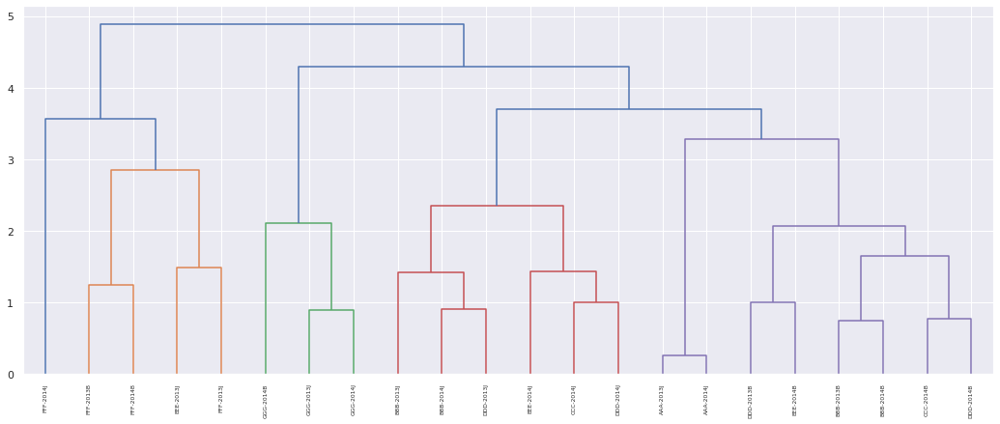

In [143]:
# Calculate the linkage: mergings
mergings = linkage(cl_courses_info,method='complete')

# Plot the dendrogram, using varieties as labels
dendrogram(mergings,
           labels=courses_label,
           leaf_rotation=90,
           leaf_font_size=6,
)
plt.show()

##### Single linkage

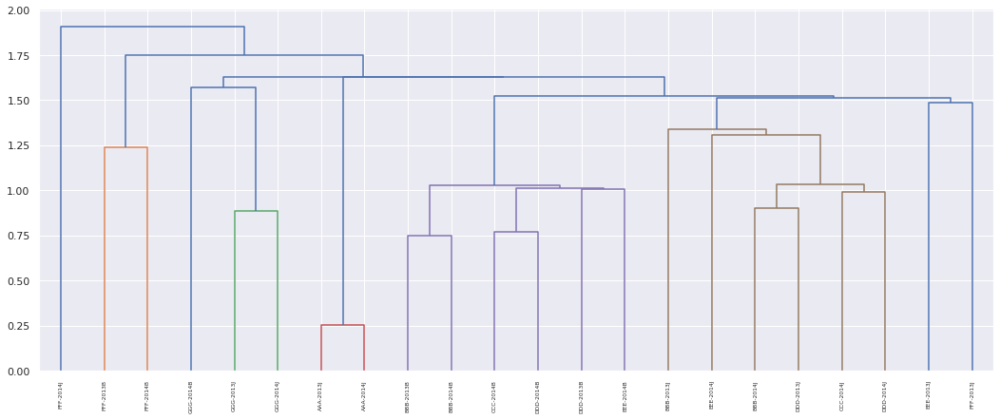

In [144]:
# Calculate the linkage: mergings
mergings = linkage(cl_courses_info,method='single')

# Plot the dendrogram, using varieties as labels
dendrogram(mergings,
           labels=courses_label,
           leaf_rotation=90,
           leaf_font_size=6,
)
plt.show()


### 2.4.1   Unsupervised analysis  on VLE activities
We will be exploring the VLE activities table(vle_final) to uncover patterns in our dataset, we will be employing the KMeans and Hierarchical clustering for this dataset.

In [145]:
vle_final

,id_site,activity_type,module_presentation_length,mod_presentation,AVG_Click_per_student,Module_Session
0,546943,resource,268,AAA-2013J,1.333333,J
1,546712,oucontent,268,AAA-2013J,6.057471,J
2,546998,resource,268,AAA-2013J,1.500000,J
3,546888,url,268,AAA-2013J,1.363636,J
4,547035,resource,268,AAA-2013J,1.473684,J
...,...,...,...,...,...,...
6263,897063,resource,269,GGG-2014J,2.285714,J
6264,897109,resource,269,GGG-2014J,1.250000,J
6265,896965,oucontent,269,GGG-2014J,16.401198,J
6266,897060,resource,269,GGG-2014J,2.146667,J


In [146]:
#creating a copy of the vle_final table.
cl_vle_info = vle_final.copy()

In [147]:
#droping the module sessions feature as it might affect our clusters
cl_vle_info  = cl_vle_info.drop(['Module_Session','mod_presentation','id_site','module_presentation_length'],axis=1)
#creaing a variable for all feature names
labs_vle = cl_vle_info.columns

In [148]:
#checking for null values
cl_vle_info.isnull().sum()

activity_type            0
AVG_Click_per_student    0
dtype: int64

### Label Encoding this dataset

In [149]:
#encoding non numeric features
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()

#converting all object features to numeric
for i in cl_vle_info.select_dtypes(include=['object']):
    cl_vle_info[i]= lab_enc.fit_transform(cl_vle_info[i].astype('str'))


### Standardizing  the dataset

In [150]:
#standardizing the data
# Import the StandardScaler
from sklearn.preprocessing  import StandardScaler

# Scale the features and set the values to a new variable
scaler = StandardScaler()
cl_vle_info = scaler.fit_transform(cl_vle_info)
#converting back
#we get the selected features by converting arrays back to df
cl_vle_columns = labs_vle.values
cl_vle_info = pd.DataFrame(cl_vle_info, columns=cl_vle_columns)
#we now have three data stud_y,stud_X and stud_X_scaled

### Principal Component Analysis on the student information table

The dataset was fitted using expecting components that explains 95% of the variability in the dataset.

In [151]:
#importing pca package
from sklearn.decomposition import PCA
# Get our explained variance ratios from PCA using all features
pca = PCA(n_components = .98)
ex_pca_vle = pca.fit_transform(cl_vle_info)

##### Plotting explained variance
We observe that we have 5 components explaining 95% of the variability in the dataset. 

Text(0.5, 1.0, 'Scree Plot')

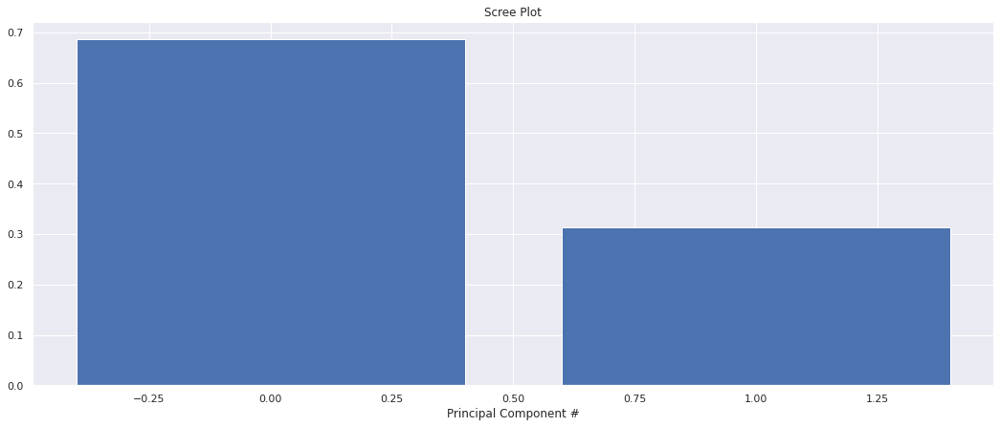

In [152]:
#variance explained by each component
ex_pca_vle_var = pca.explained_variance_ratio_
#number of components
ex_pca_vle_ncomp = pca.n_components_
# plot the explained variance using a barplot
fig, ax = plt.subplots()
ax.bar(range(ex_pca_vle_ncomp), ex_pca_vle_var)
ax.set_xlabel('Principal Component #')
ax.set_title('Scree Plot')

##### Plotting cumulative variance
The cumulative variance plot also validates the number of components as approximately 5.

Text(0.5, 1.0, 'Cummulative variance Plot')

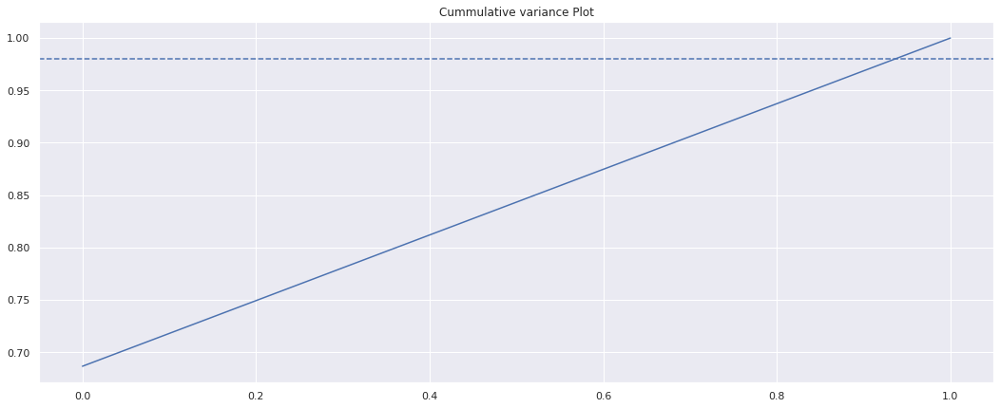

In [153]:
import numpy as np

# Calculate the cumulative explained variance
ex_pca_vle_cum = np.cumsum(ex_pca_vle_var)

# Plot the cumulative explained variance and draw a dashed line at 0.95.
fig, ax = plt.subplots()
ax.plot(ex_pca_vle_cum)
#components explaining 95% of variance in the data
ax.axhline(y=0.98, linestyle='--')
ax.set_title('Cummulative variance Plot')

###### Creating the Principal component projections of the data

In [154]:
ex_pca_vle = pd.DataFrame(ex_pca_vle, columns = ['PC1','PC2']) 

##### Correlation check
We can observe no correlation among the principal components.

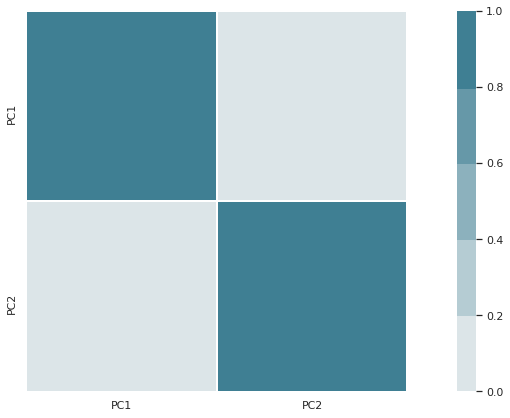

In [155]:
corr = ex_pca_vle.corr()
import seaborn as sns

cor_mat = sns.heatmap(
    corr,
  center = 0,
    cmap = sns.diverging_palette(20,220, n = 10),
    square = True,
    linewidths = 0.5
)

### Scatter plot of the  VLE
The scatterplot for the principal components of the Student Information table was plotted to give a view of the distribution of the datapoints in a dataspace.

In [156]:
#creating dataframe of principal projections
pca_projections_vle = ex_pca_vle.join(vle_final)

In [157]:
pca_projections_vle['Module_Session'].value_counts()

J    3404
B    2864
Name: Module_Session, dtype: int64

In [158]:
#creating different dataframes for the different final result classes
Feb = pca_projections_vle[pca_projections_vle['Module_Session'] == 'B']
Oct = pca_projections_vle[pca_projections_vle['Module_Session'] == 'J']

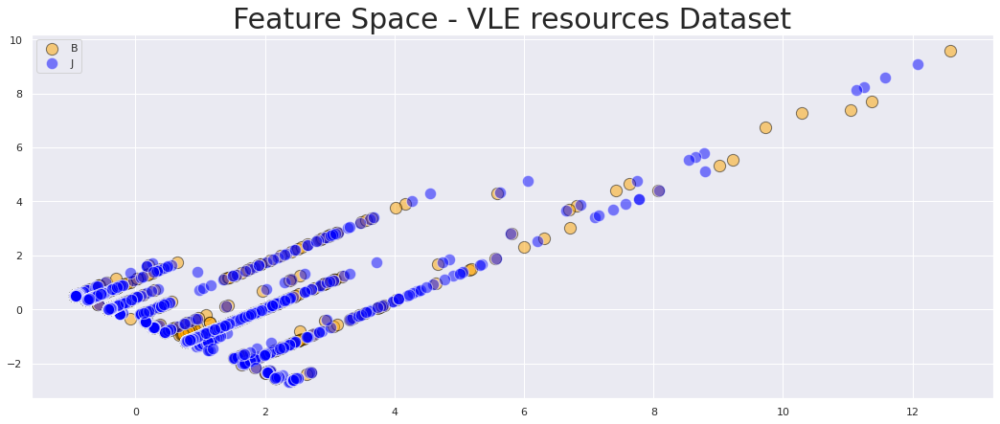

In [159]:
# Make a scatter plot of pca1 and pca1 coloring by the final result class
plt.scatter(Feb['PC1'],Feb['PC2'],c = 'orange', label = 'B', s=150,alpha=0.5,edgecolors='black')
plt.scatter(Oct['PC1'],Oct['PC2'],c = 'blue', label = 'J',s=150,alpha=0.5,edgecolors='white')
plt.title('Feature Space - VLE resources Dataset',fontsize = 30)
plt.legend()
plt.show()

### Kmeans Algorithm

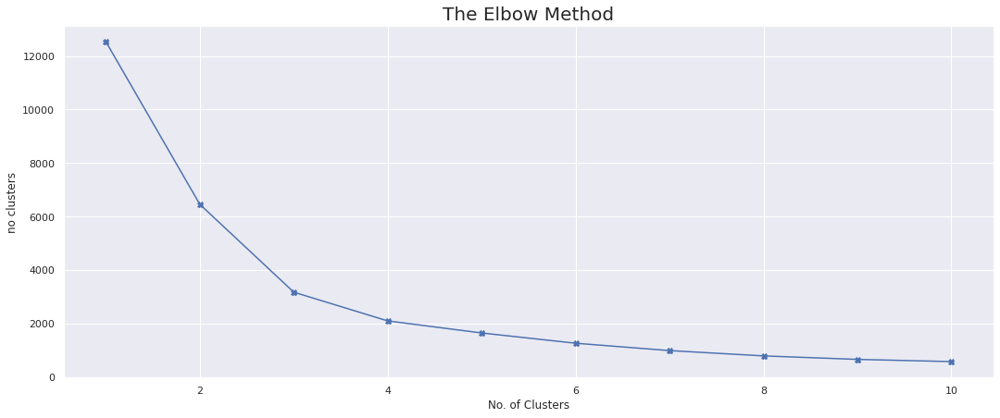

In [160]:

#importing the KMeans package
from sklearn.cluster import KMeans

#initiate an empty list to hold number of clusters
no_cluster = []
#loop through within a range of 1 to 11 and append inertias for each loop to the empty list
for i in range(1, 11):
    km = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    km.fit(ex_pca_vle)
    no_cluster.append(km.inertia_)
    
plt.plot(range(1, 11), no_cluster,marker = 'X')
plt.title('The Elbow Method', fontsize = 20)
plt.xlabel('No. of Clusters')
plt.ylabel('no clusters')
plt.show()


In [161]:
#running KMeans algorithm with 3 clusters
km = KMeans(n_clusters = 3, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
#using the fit predict method to predict the clusters each feature belongs to
km_labels_vle = km.fit_predict(ex_pca_vle.values)

In [162]:
pca_projections_km_vle = ex_pca_vle.join(pd.DataFrame(km_labels_vle,columns=['cluster']))
cluster1_km_vle = pca_projections_km_vle[pca_projections_km_vle['cluster'] == 0]
cluster2_km_vle = pca_projections_km_vle[pca_projections_km_vle['cluster'] == 1]
cluster3_km_vle = pca_projections_km_vle[pca_projections_km_vle['cluster'] == 2]

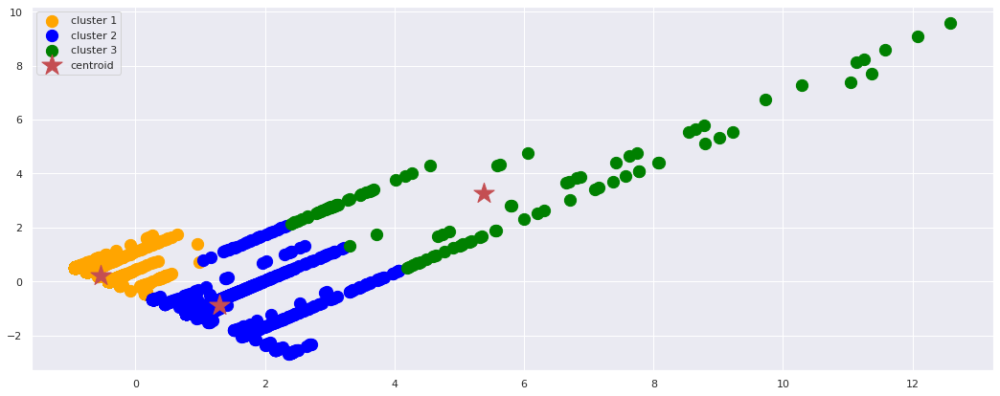

In [163]:
# Make a scatter plot of xs and ys, using labels_stud to define the colors
plt.scatter(cluster1_km_vle['PC1'],cluster1_km_vle['PC2'],c = 'orange', label = 'cluster 1', s=150)
plt.scatter(cluster2_km_vle['PC1'],cluster2_km_vle['PC2'],c = 'blue', label = 'cluster 2',s=150)
plt.scatter(cluster3_km_vle['PC1'],cluster3_km_vle['PC2'],c = 'green', label = 'cluster 3',s=150)
plt.legend()
# Assign the cluster centers: centroids
centroids = km.cluster_centers_

# Assign the columns of centroids: centroids_x, centroids_y
centroids_x = centroids[:,0]
centroids_y = centroids[:,1]


# Make a scatter plot of centroids_x and centroids_y
plt.scatter(centroids_x,centroids_y,marker="*",s=500, label = 'centroid', c='r')
plt.legend()
plt.show()

### Hierarchial Clustering Algorithm

In [164]:
#import the AgglomerativeClustering package
from sklearn.cluster import AgglomerativeClustering
#create an object of the class with number of clusters, affinity and the linkage
agglo_model = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage = 'ward')
hc_label_vle = agglo_model.fit_predict(ex_pca_vle.values)

In [165]:
pca_projections_vle=pca_projections_hc_vle = ex_pca_vle.join(pd.DataFrame(hc_label_vle,columns=['cluster']))
cluster1_hc_vle = pca_projections_hc_vle[pca_projections_hc_vle['cluster'] == 0]
cluster2_hc_vle = pca_projections_hc_vle[pca_projections_hc_vle['cluster'] == 1]
cluster3_hc_vle = pca_projections_hc_vle[pca_projections_hc_vle['cluster'] == 2]

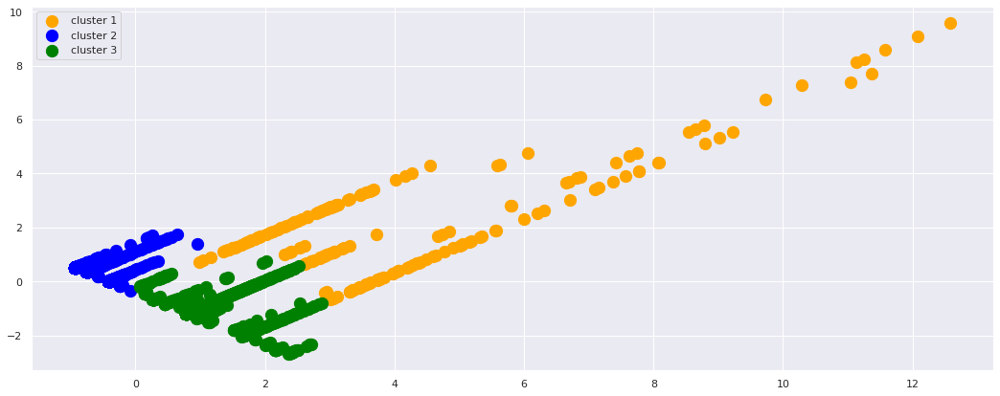

In [166]:
# Make a scatter plot of xs and ys, using labels_stud to define the colors
plt.scatter(cluster1_hc_vle['PC1'],cluster1_hc_vle['PC2'],c = 'orange', label = 'cluster 1', s=150)
plt.scatter(cluster2_hc_vle['PC1'],cluster2_hc_vle['PC2'],c = 'blue', label = 'cluster 2',s=150)
plt.scatter(cluster3_hc_vle['PC1'],cluster3_hc_vle['PC2'],c = 'green', label = 'cluster 3',s=150)
plt.legend()


plt.legend()
plt.show()

### Evaluating Clustering Algorithm Performance

#### Cross Tabulating KMEANS

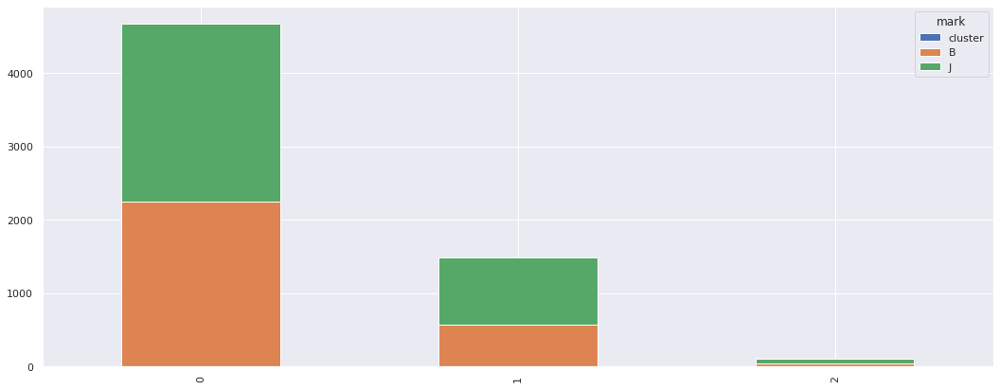

In [167]:
vle_res_labels = vle_final['Module_Session']
km_ct_temp_vle = ex_pca_vle.join(pd.DataFrame(km_labels_vle))
km_ct_temp_vle = km_ct_temp_vle.join(pd.DataFrame(vle_res_labels))
km_ct_temp_vle = km_ct_temp_vle.rename(index=str, columns={0:'cluster'})
km_ct_vle = pd.crosstab(km_ct_temp_vle['cluster'],km_ct_temp_vle['Module_Session']).reset_index()
#Kmeans crosstab
#plotting the crosstab
km_ct_vle.plot.bar(stacked=True)
plt.legend(title='mark')

plt.show()

#### Cross Tabulating Hierarchial

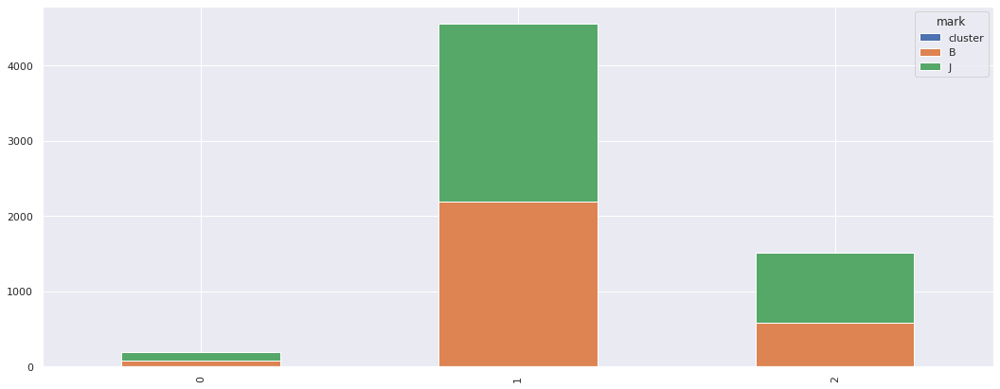

In [168]:
hc_ct_temp_vle = ex_pca_vle.join(pd.DataFrame(hc_label_vle))
hc_ct_temp_vle = hc_ct_temp_vle.join(pd.DataFrame(vle_res_labels))
hc_ct_temp_vle = hc_ct_temp_vle.rename(index=str, columns={0:'cluster'})
hc_ct_vle = pd.crosstab(hc_ct_temp_vle['cluster'],hc_ct_temp_vle['Module_Session']).reset_index()
hc_ct_vle.plot.bar(stacked=True)
plt.legend(title='mark')

plt.show()

#### Numerical Evaluation of Algorithms

#### silhouette_score Evaluation

In [169]:
#Calculate the Silhouette Coefficient score for all the algorithms
kmeans_score = silhouette_score(ex_pca_vle, km_labels_vle, 
                                metric='euclidean')
hierarchical_score = silhouette_score(ex_pca_vle, hc_label_vle, 
                                metric='euclidean')
print(kmeans_score,hierarchical_score)


0.7398638660062727 0.7298484048943104


#### calinski_harabasz_score Evaluation

In [170]:
#Calculate the Calinski–Harabasz index for all the algorithms
kmeans_score_ch = calinski_harabasz_score(ex_pca_vle, km_labels_vle)
hc_score_ch = calinski_harabasz_score(ex_pca_vle, hc_label_vle)

print(kmeans_score_ch,hc_score_ch)

9238.785703467203 8271.84972010594


## 2.5.0   Task C: Supervised analysis
We have created the features and labels for our student information dataset which are listed below, we will be proceeding with the supervised analysis of this dataset to make predictions on the student information.

<img src="sup.gif">

### 2.5.1 Predicting Withdraw or Fail

In line with the aim of this task, we will be perfroming a classification task on the student information dataset to predict if a student will fail or withdraw. We have 3 classes for this feature so we will be filtering out students who passed and focus only on students who Failed or Withdrew from the course. We will use techniques such as Label Encoding to encode categorical features and standardizing the dataset using Sklearn's StandardScaler module. We will remove highly correlated and low variance features and use Recursive Feature Elimination (RFE) for Feature Selection.  Finally, we will implement four different classification algorithms on this dataset and evaluate their performances.

#### Filtering for Fail and Withdrawn
In line with the aim of this task which is to preduct if a student will fail or withdraw from a course we will be filtering for Fail and Withdrawn class.

In [171]:
class_std_info = std_info_final_copy[std_info_final_copy['final_result_calc'] != 'Pass']

In [172]:
#check for null values
class_std_info.isnull().sum()

gender                        0
region                        0
highest_education             0
age_band                      0
num_of_prev_attempts          0
studied_credits               0
disability                    0
mod_presentation              0
ast_weighted_grade            0
Exam_score                    0
sum_click                     0
avg_daily_click               0
Distinct_intrct_days          0
date_registration             0
Module_Session                0
module_presentation_length    0
imd_band_Deprivity            0
final_result_calc             0
dtype: int64

In [173]:
#check table information
class_std_info.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10142 entries, 14 to 25788
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   gender                      10142 non-null  object 
 1   region                      10142 non-null  object 
 2   highest_education           10142 non-null  object 
 3   age_band                    10142 non-null  object 
 4   num_of_prev_attempts        10142 non-null  int64  
 5   studied_credits             10142 non-null  int64  
 6   disability                  10142 non-null  object 
 7   mod_presentation            10142 non-null  object 
 8   ast_weighted_grade          10142 non-null  float64
 9   Exam_score                  10142 non-null  float64
 10  sum_click                   10142 non-null  int64  
 11  avg_daily_click             10142 non-null  float64
 12  Distinct_intrct_days        10142 non-null  int64  
 13  date_registration           10

### Label Encoding the dataset

In [174]:
#encoding non numerical features
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()

#converting all object features to numeric
for i in class_std_info.select_dtypes(include=['object']):
    class_std_info[i]= lab_enc.fit_transform(class_std_info[i].astype('str'))
targ_class_y = class_std_info['final_result_calc']

In [175]:
#get back the classes after encoding
list(lab_enc.inverse_transform([0,1]))

['Fail', 'Withdrawn']

### Standardizing the dataset

In [176]:
#standardizing the data
# Import the StandardScaler
from sklearn.preprocessing  import StandardScaler

# Scale the features and set the values to a new variable
scaler = StandardScaler()
class_std_info = scaler.fit_transform(class_std_info)
#converting back
#we get the selected features by converting arrays back to dataframe
columns_data_stud = std_info_final_copy.columns.values
class_std_info = pd.DataFrame(class_std_info, columns=columns_data_stud)

### Remove highly correlated features
We will be removing highly correlated features from the dataset. This helps avoid redundancy in the features used for building the model and help avoid overfitting.

<AxesSubplot:>

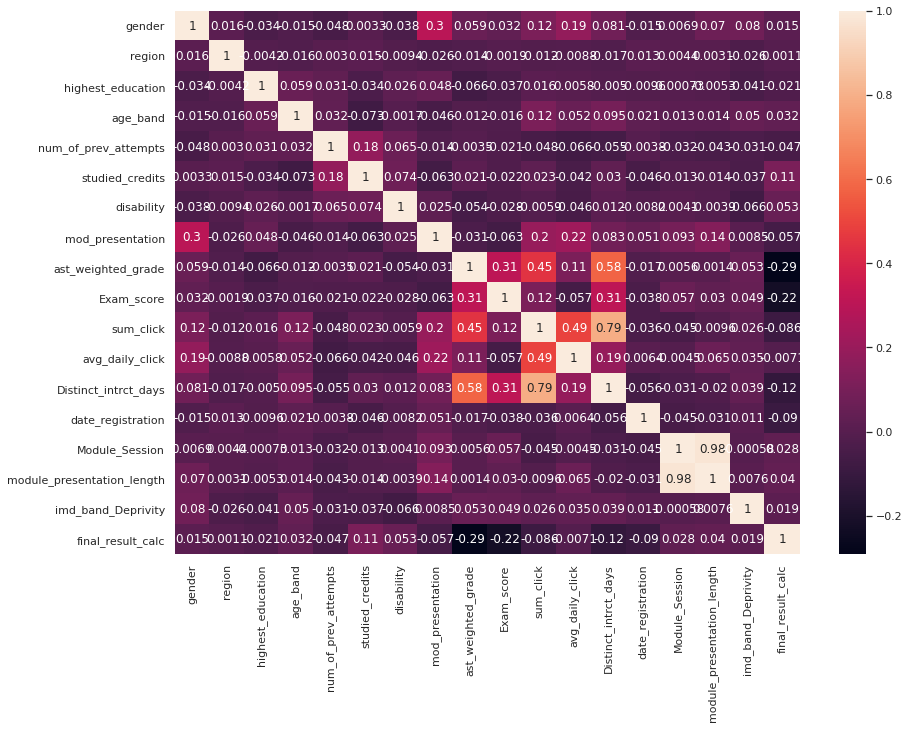

In [177]:
# Create a correlation matrix, we will leave the correlation we expect it
plt.figure(figsize=(14,10))
sns.heatmap(class_std_info.corr(),annot=True)

We filtered out features with correlation coefficient greater than 0.5. We have two features that matches this criteria and they were removed from the dataset.

In [178]:
#get absolute value of correlation values
corr_matrix = class_std_info.corr().abs()

#get features and their correlated features into a matrix
upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape),k=1).astype(np.bool))

#drop features with correlation value greater than 0.5
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.5)]

print(); print(to_drop)



['Distinct_intrct_days', 'module_presentation_length']


In [179]:
#dropping highly correlated features
class_std_info = class_std_info.drop(class_std_info[to_drop], axis=1)

### Remove features with low variance

In sklearn’s feature selection module we find VarianceThreshold. It removes all features whose variance doesn’t meet some threshold. By default it removes features with zero variance or features that have the same value for all samples.

In [180]:
from sklearn import feature_selection

sel = feature_selection.VarianceThreshold()
train_variance = sel.fit_transform(class_std_info)
train_variance.shape

(10142, 16)

We used the var method to check variance of all features and we observed uniform variance among all features.

In [181]:
class_std_info.var()

gender                  1.000099
region                  1.000099
highest_education       1.000099
age_band                1.000099
num_of_prev_attempts    1.000099
studied_credits         1.000099
disability              1.000099
mod_presentation        1.000099
ast_weighted_grade      1.000099
Exam_score              1.000099
sum_click               1.000099
avg_daily_click         1.000099
date_registration       1.000099
Module_Session          1.000099
imd_band_Deprivity      1.000099
final_result_calc       1.000099
dtype: float64

### Recursive Feature elimination RFE
<p>We will be using the Recursive feature selection technique, which takes advantage of the fact that some machine learning algorithms attach weight and importance to features using the coef_ or feature_importances_ method. This means we will be selecting our features with the aid of machine learning algorithms by selecting the important features in the dataset.

<p>RFE was used due to its iterative approach to feature selection by pruning out features it deem weak among the list of features in the dataset.</p> 


##### Performing a Data Partition on a Sample Dataset

In this step, we will be splitting the dataset into partitions of training set, and test set. This would form the basis of the data we will use to train our data for the supervised learning task, validate the data and then perform some real world prediction on the test set.

In [182]:
#importing the train_test_split function
from sklearn.model_selection import train_test_split
#splitting the data into train test
class_X = class_std_info.drop(['final_result_calc'],axis=1)
class_Y = targ_class_y
#print the shape of the dataset
print(class_X.shape,class_Y.shape)


(10142, 15) (10142,)


In [183]:
#performing the train test split
class_X_train_std,class_X_test_std,class_Y_train_std,class_Y_test_std = train_test_split\
(class_X,class_Y, test_size=0.3, random_state=123)

In [184]:
#printing out shape of new subset
print(class_X_train_std.shape, class_X_test_std.shape, class_Y_train_std.shape, class_Y_test_std.shape)

(7099, 15) (3043, 15) (7099,) (3043,)


##### RFE Logistic Regression
Logistic regression attaches weight of importance to each feature in the dataset. We will be using this to select the most important features for our model.

##### Logistic Regression on all features

In [185]:
#create the logistic model
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

#assign the logistic function
lr = LogisticRegression(max_iter = 300)
lr.fit(class_X_train_std,class_Y_train_std)

class_Y_pred = lr.predict(class_X_test_std)
print(accuracy_score(class_Y_test_std,class_Y_pred))

0.6677620768977982


In [186]:
print(lr.coef_)

[[ 0.1106024  -0.0337658  -0.09273906  0.08005527 -0.16584803  0.23503873
   0.10465068 -0.2485548  -0.68194512 -1.58696571  0.18259612 -0.01573997
  -0.20100344  0.0916025   0.09334182]]


In [187]:
print(dict(zip(class_X.columns, abs(lr.coef_[0]))))

{'gender': 0.11060240423377597, 'region': 0.03376579621013092, 'highest_education': 0.09273905784324098, 'age_band': 0.08005527046337482, 'num_of_prev_attempts': 0.16584803319394803, 'studied_credits': 0.23503873184680027, 'disability': 0.10465068294263152, 'mod_presentation': 0.2485548024907294, 'ast_weighted_grade': 0.6819451152973277, 'Exam_score': 1.5869657078482435, 'sum_click': 0.18259612300271152, 'avg_daily_click': 0.015739974677558416, 'date_registration': 0.2010034415146718, 'Module_Session': 0.09160249827768187, 'imd_band_Deprivity': 0.0933418241122936}


##### RFE selection of top 8 features
Multiple values of n_features_to_select parameter for the RFE function was tested and we concluded 8 was the right amount of feature to use, this was because it was the number of feature that gave us the closest accuracy to the accuracy score from using all 15 features in the dataset.

In [188]:
from sklearn.feature_selection import RFE
rfe_log = RFE(estimator=LogisticRegression(max_iter = 300),n_features_to_select =8, verbose=1)
rfe_log.fit(class_X_train_std,class_Y_train_std)

Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.


RFE(estimator=LogisticRegression(max_iter=300), n_features_to_select=8,
    verbose=1)

In [189]:
#get the columns we have left
class_X.columns[rfe_log.support_]

Index(['gender', 'num_of_prev_attempts', 'studied_credits', 'mod_presentation',
       'ast_weighted_grade', 'Exam_score', 'sum_click', 'date_registration'],
      dtype='object')

In [190]:
reduced_X_LOG = class_X.loc[:, class_X.columns[rfe_log.support_]]

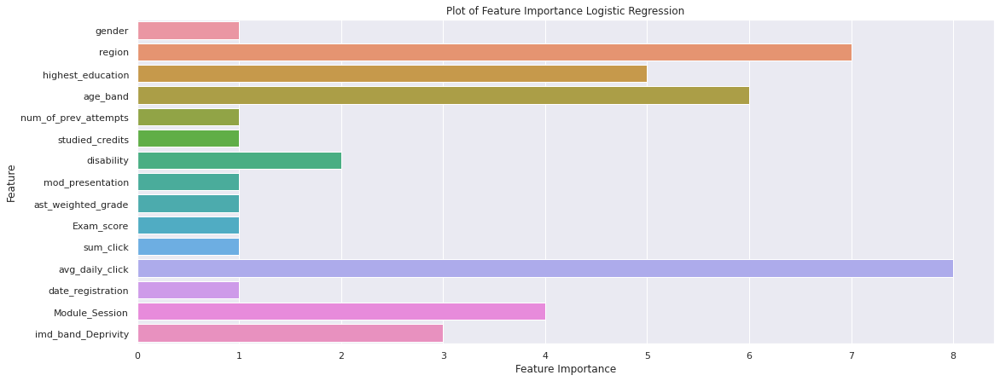

In [191]:
impt_feature = dict(zip(class_X.columns, rfe_log.ranking_))
impt_feature = pd.DataFrame.from_dict(impt_feature,orient='index',columns=['importance']).reset_index()
impt_feature = impt_feature.rename(columns={"index": "Feature"})

#plotting boxplot of the student by courses and region
_ = sns.barplot(x = 'importance', y = 'Feature', data= impt_feature, orient="h").\
    set_title("Plot of Feature Importance Logistic Regression")
#create the x axis label
_ = plt.xlabel('Feature Importance')
#create the y axis label
_ = plt.ylabel('Feature')
plt.show()

In [192]:
# Create a mask using an attribute of rfe
rfe_LOG_mask = rfe_log.support_

In [193]:
print(accuracy_score(class_Y_test_std, rfe_log.predict(class_X_test_std)))

0.6628327308577062


#### RFE Random forest Modelling

In [194]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

In [195]:
rf = RandomForestClassifier()
rf.fit(class_X_train_std,class_Y_train_std)
class_Y_pred_RF = rf.predict(class_X_test_std)
print(accuracy_score(class_Y_test_std,class_Y_pred_RF))

0.6845218534341111


In [196]:
from sklearn.feature_selection import RFE
rfe_RF = RFE(estimator=RandomForestClassifier(),n_features_to_select =8, verbose=1)
rfe_RF.fit(class_X_train_std,class_Y_train_std)

Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.


RFE(estimator=RandomForestClassifier(), n_features_to_select=8, verbose=1)

In [197]:
# Create a mask using an attribute of rfe
rfe_RF_mask = rfe_RF.support_

In [198]:
# Apply the mask to the feature dataset X and print the result
reduced_X_RF = class_X.loc[:, rfe_RF_mask]
print(reduced_X_RF.columns)

Index(['region', 'studied_credits', 'mod_presentation', 'ast_weighted_grade',
       'Exam_score', 'sum_click', 'avg_daily_click', 'date_registration'],
      dtype='object')


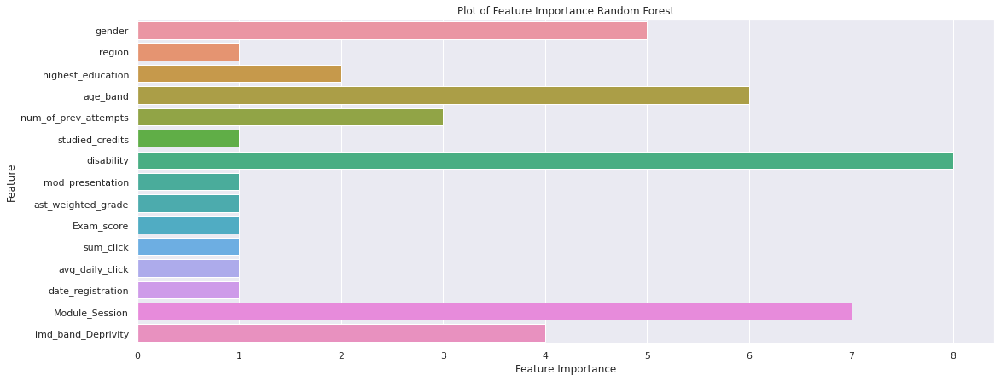

In [199]:
rf_feature = dict(zip(class_X.columns, rfe_RF.ranking_))
rf_feature = pd.DataFrame.from_dict(rf_feature,orient='index',columns=['importance']).reset_index()
rf_feature = rf_feature.rename(columns={"index": "Feature"})

#plotting boxplot of the student by courses and region
_ = sns.barplot(x = 'importance', y = 'Feature', data= rf_feature, orient="h").\
    set_title("Plot of Feature Importance Random Forest")
#create the x axis label
_ = plt.xlabel('Feature Importance')
#create the y axis label
_ = plt.ylabel('Feature')
plt.show()

In [200]:
print(accuracy_score(class_Y_test_std, rfe_RF.predict(class_X_test_std)))

0.6795925073940191


##### Combining selected features from both model

We will be using a voting system to decide which features to use by comnining selected features from both models. We will count the vote for a feature by both models and keep only models that have two votes and this features will be used to model the aim of this task.

In [201]:
votes = np.sum([rfe_LOG_mask, rfe_RF_mask], axis=0)
print(votes)

[1 1 0 0 1 2 0 2 2 2 2 1 2 0 0]


In [202]:
#pick features with 2 votes
rfe_mask = votes == 2
reduced_X_class = class_X.loc[:, rfe_mask]

In [203]:
#performing the train test split
class_X_train_std,class_X_test_std,class_Y_train_std,class_Y_test_std = train_test_split\
(reduced_X_class,class_Y, test_size=0.3, random_state=123)

#### Final features
The final output of the feature selection process shows we have 6 important features for predicting if a student will fail or withdraw from a course.

In [204]:
reduced_X_class.columns

Index(['studied_credits', 'mod_presentation', 'ast_weighted_grade',
       'Exam_score', 'sum_click', 'date_registration'],
      dtype='object')

### 2.5.1   Classification analysis  on student information

#### Performing test split on final selected features

In [205]:
#performing the train test split
class_X_train_std,class_X_test_std,class_Y_train_std,class_Y_test_std = train_test_split\
(reduced_X_class,class_Y, test_size=0.2, random_state=123)

### Naive Bayes classifier

In [206]:
#importing the Naive Bayes classifier
from sklearn.naive_bayes import GaussianNB

In [207]:
#instantiating the model
model_NB = GaussianNB()
clf_NB = model_NB.fit(class_X_train_std,class_Y_train_std) 

#### Predict the results 

In [208]:
#predicting on the test dataset
y_pred_class = model_NB.predict(class_X_test_std)

In [209]:
#checking score accuracy
from sklearn.metrics import accuracy_score

print('Model accuracy score: {0:0.4f}'. format(accuracy_score(class_Y_test_std, y_pred_class)))

Model accuracy score: 0.5461


In [210]:
#Compare the train-set and test-set accuracy
y_pred_train = model_NB.predict(class_X_train_std)

In [211]:
print('Training-set accuracy score: {0:0.4f}'. format(accuracy_score(class_Y_train_std, y_pred_train)))

Training-set accuracy score: 0.5540


In [212]:
#checking for overfitting
# print the scores on training and test set

print('Training set score: {:.4f}'.format(model_NB.score(class_X_train_std, class_Y_train_std)))

print('Test set score: {:.4f}'.format(model_NB.score(class_X_test_std, class_Y_test_std)))

Training set score: 0.5540
Test set score: 0.5461


The training-set accuracy score is 0.5490 while the test-set accuracy to be 0.5542. These two values are quite comparable. So, there is no evidence of overfitting.

**Compare model accuracy with null accuracy**<br/>
So, the model accuracy is 0.6279. Comparing our model accuract with the Null accuracy which is the accuracy that could be achieved by always predicting the most frequent class.

In [213]:
# check class distribution in test set

class_Y_test_std.value_counts()
#most frequent class is 1

# check null accuracy score

null_accuracy = (1126/(1126+903))

print('Null accuracy score: {0:0.4f}'. format(null_accuracy))

Null accuracy score: 0.5550


We can see that our model accuracy score is 0.6279 but null accuracy score is 0.5550. So, we can conclude that our Gaussian Naive Bayes Classification model is doing a better job than selecting the most frequent class in the dataset.

##### Confusion Matrix
To check the underlying distribution of values and the type of errors our classifer is making we will be using a tool called Confusion matrix.

In [214]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(class_Y_test_std, y_pred_class)

print('Confusion matrix\n\n', cm)


Confusion matrix

 [[243 883]
 [ 38 865]]


In [215]:
class_names = ['Fail','Withdrawn']

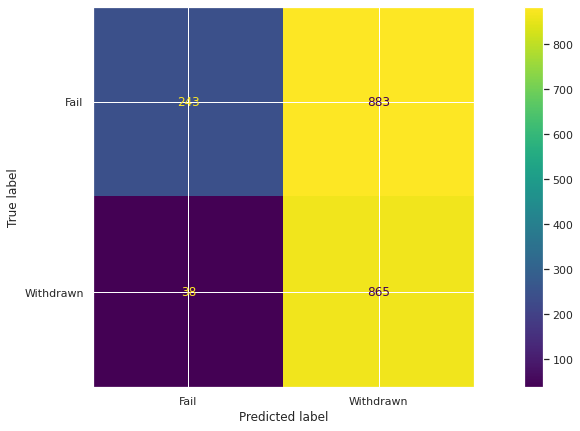

In [216]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(clf_NB, class_X_test_std, class_Y_test_std,display_labels=class_names)  

### Decision Trees

In [217]:
#import the decision trees function
from sklearn.tree import DecisionTreeClassifier

In [218]:
#instantiate the decision trees model
model_tree = DecisionTreeClassifier(criterion = 'entropy', random_state = 123,max_depth = 4)

In [219]:
#fit the model to the training set
model_tree.fit(class_X_train_std, class_Y_train_std)

DecisionTreeClassifier(criterion='entropy', max_depth=4, random_state=123)

In [220]:
#Compare the train-set and test-set accuracy
y_pred_model_tree = model_tree.predict(class_X_test_std)

In [221]:
#get the accuracy score of the training set
model_tree.score(class_X_train_std, class_Y_train_std)

0.6657216812523111

In [222]:
#get the accuracy of the test set
model_tree.score(class_X_test_std, class_Y_test_std)

0.6540167570231641

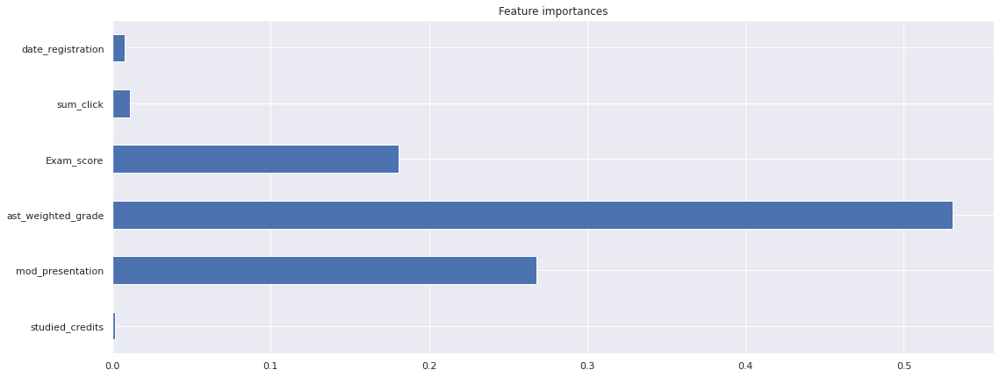

In [223]:
model_tree_feature_importances = pd.Series(model_tree.feature_importances_,
 index = reduced_X_class.columns)
_ = model_tree_feature_importances.plot(kind = 'barh')
_ = plt.title("Feature importances")

In [224]:
#checking for overfitting
# print the scores on training and test set

print('Training set score: {:.4f}'.format(model_tree.score(class_X_train_std, class_Y_train_std)))

print('Test set score: {:.4f}'.format(model_tree.score(class_X_test_std, class_Y_test_std)))

Training set score: 0.6657
Test set score: 0.6540


The training-set accuracy score is 0.6536 while the test-set accuracy to be 0.6471. These two values are quite comparable. So, there is no evidence of overfitting.

**Compare model accuracy with null accuracy**<br/>

We can see that our model accuracy score is 0.6471 but null accuracy score is 0.5550. This means our model is better than predicting the most frequent class in the dataset.

##### Confusion Matrix
Checking prediction distribution

In [225]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(class_Y_test_std, y_pred_model_tree)

print('Confusion matrix\n\n', cm)


Confusion matrix

 [[649 477]
 [225 678]]


In [226]:
class_names = ['Fail','Withdrawn']

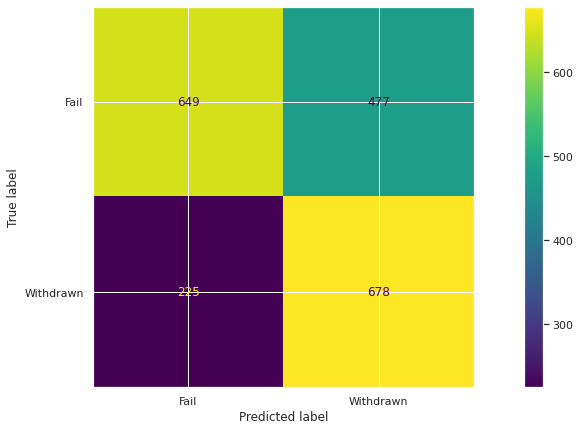

In [227]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(model_tree, class_X_test_std, class_Y_test_std,display_labels=class_names)  

### Support Vector Machine Algorithm

In [228]:
from sklearn.svm import SVC

In [229]:
model_svm = SVC()
model_svm.fit(class_X_train_std, class_Y_train_std)

SVC()

In [230]:
model_svm_pred_test = model_svm.predict(class_X_test_std)

In [231]:
#getting the accuracy score of training test
model_svm.score(class_X_train_std, class_Y_train_std)

0.6882780722297547

In [232]:
#getting the accuracy of the test set
model_svm.score(class_X_test_std, class_Y_test_std)

0.6880236569738788

In [233]:
#checking for overfitting
# print the scores on training and test set

print('Training set score: {:.4f}'.format(model_svm.score(class_X_train_std, class_Y_train_std)))

print('Test set score: {:.4f}'.format(model_svm.score(class_X_test_std, class_Y_test_std)))

Training set score: 0.6883
Test set score: 0.6880


The training-set accuracy score is 0.6916 while the test-set accuracy to be  0.6782. These two values are quite comparable. So, there is no evidence of overfitting.

**Compare model accuracy with null accuracy**<br/>

We can see that our model accuracy score is 0.6782 but null accuracy score is 0.5550. This means our model is better than predicting the most frequent class in the dataset.

##### Confusion Matrix
Checking prediction distribution

In [234]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix

cm = confusion_matrix(class_Y_test_std, model_svm_pred_test)

print('Confusion matrix\n\n', cm)


Confusion matrix

 [[757 369]
 [264 639]]


In [235]:
class_names = ['Fail','Withdrawn']

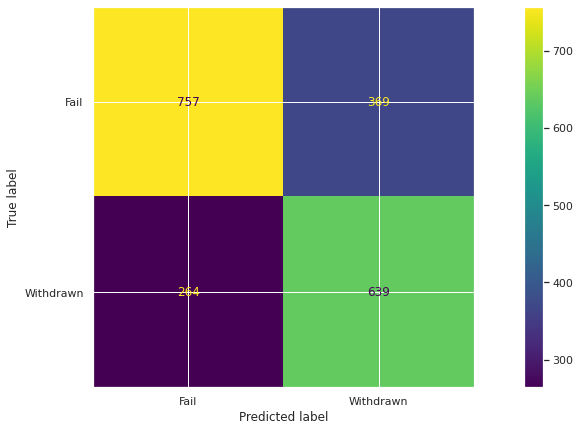

In [236]:
from sklearn.metrics import plot_confusion_matrix
plot_confusion_matrix(model_svm, class_X_test_std, class_Y_test_std,display_labels=class_names)  

### Error Analysis
We will measure our models performance using the Accuracy, precision and recall of all models used.

In [237]:
#importing the metrics and measurement modules
from sklearn.metrics import accuracy_score, precision_score, recall_score

In [238]:
#creating a list of train test data to be used
X_sets = [class_X_train_std, class_X_test_std]
Y_sets = [class_Y_train_std, class_Y_test_std]

In [239]:
#create a dictionary to hold the evaluation metricss
metrics = {"NB":{"Acc":[],"Pre":[],"Rec":[]},
           "DT":{"Acc":[],"Pre":[],"Rec":[]},
           "SVM":{"Acc":[],"Pre":[],"Rec":[]}}

In [240]:
#loop through the different data groups
for i in [0,1]:
    pred_NB = model_NB.predict(X_sets[i])
    metrics["NB"]["Acc"].append(accuracy_score(Y_sets[i], pred_NB))
    metrics["NB"]["Pre"].append(precision_score(Y_sets[i], pred_NB))
    metrics["NB"]["Rec"].append(recall_score(Y_sets[i], pred_NB))
    pred_tree = model_tree.predict(X_sets[i])
    metrics["DT"]["Acc"].append(accuracy_score(Y_sets[i], pred_tree))
    metrics["DT"]["Pre"].append(precision_score(Y_sets[i], pred_tree))
    metrics["DT"]["Rec"].append(recall_score(Y_sets[i], pred_tree))
    pred_svm = model_svm.predict(X_sets[i])
    metrics["SVM"]["Acc"].append(accuracy_score(Y_sets[i], pred_svm))
    metrics["SVM"]["Pre"].append(precision_score(Y_sets[i], pred_svm))
    metrics["SVM"]["Rec"].append(recall_score(Y_sets[i], pred_svm))

In [241]:
print(metrics)

{'NB': {'Acc': [0.5540490570689017, 0.5460818137013307], 'Pre': [0.5006402048655569, 0.4948512585812357], 'Rec': [0.9702233250620348, 0.9579180509413068]}, 'DT': {'Acc': [0.6657216812523111, 0.6540167570231641], 'Pre': [0.5992192582953806, 0.587012987012987], 'Rec': [0.7617866004962779, 0.7508305647840532]}, 'SVM': {'Acc': [0.6882780722297547, 0.6880236569738788], 'Pre': [0.6380090497737556, 0.6339285714285714], 'Rec': [0.6997518610421837, 0.707641196013289]}}


In [242]:
Error_analysis = pd.DataFrame.from_dict({(i,j): metrics[i][j] 
                           for i in metrics.keys() 
                           for j in metrics[i].keys()},
                       orient='index',columns=['Train', 'Test'])
Error_analysis = Error_analysis.reset_index().rename(columns={"index":"Models"})

In [243]:
Error_analysis

,Models,Train,Test
0,"(NB, Acc)",0.554049,0.546082
1,"(NB, Pre)",0.500640,0.494851
2,"(NB, Rec)",0.970223,0.957918
3,"(DT, Acc)",0.665722,0.654017
4,"(DT, Pre)",0.599219,0.587013
5,"(DT, Rec)",0.761787,0.750831
6,"(SVM, Acc)",0.688278,0.688024
7,"(SVM, Pre)",0.638009,0.633929
8,"(SVM, Rec)",0.699752,0.707641


### 2.5.2   Regression analysis:  Predict the weighted assessment for Fail and Withdrawn
In this section of this task we will predict the weighted assessment grade of student who Fail or Withdraw from the courses in this dataset.

In [244]:
#creating a copy of the dataset
reg_std_FW = std_info_final_copy[std_info_final_copy['final_result_calc'] != 'Pass']

In [245]:
#checking for null values
reg_std_FW.isnull().sum()

gender                        0
region                        0
highest_education             0
age_band                      0
num_of_prev_attempts          0
studied_credits               0
disability                    0
mod_presentation              0
ast_weighted_grade            0
Exam_score                    0
sum_click                     0
avg_daily_click               0
Distinct_intrct_days          0
date_registration             0
Module_Session                0
module_presentation_length    0
imd_band_Deprivity            0
final_result_calc             0
dtype: int64

In [246]:
#checking table info
reg_std_FW.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10142 entries, 14 to 25788
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   gender                      10142 non-null  object 
 1   region                      10142 non-null  object 
 2   highest_education           10142 non-null  object 
 3   age_band                    10142 non-null  object 
 4   num_of_prev_attempts        10142 non-null  int64  
 5   studied_credits             10142 non-null  int64  
 6   disability                  10142 non-null  object 
 7   mod_presentation            10142 non-null  object 
 8   ast_weighted_grade          10142 non-null  float64
 9   Exam_score                  10142 non-null  float64
 10  sum_click                   10142 non-null  int64  
 11  avg_daily_click             10142 non-null  float64
 12  Distinct_intrct_days        10142 non-null  int64  
 13  date_registration           10

### Label Encoding the dataset

In [247]:
#encoding non numerical columns
from sklearn.preprocessing import LabelEncoder
lab_enc = LabelEncoder()

#converting all object features to numeric
for i in reg_std_FW.select_dtypes(include=['object']):
    reg_std_FW[i]= lab_enc.fit_transform(reg_std_FW[i].astype('str'))
targ_reg_y = reg_std_FW['ast_weighted_grade']

In [248]:
#show original encoding
list(lab_enc.inverse_transform([0,1]))

['Fail', 'Withdrawn']

### Standardizing the dataset

In [249]:
#standardizing the data
# Import the StandardScaler
from sklearn.preprocessing  import StandardScaler

# Scale the features and set the values to a new variable
scaler = StandardScaler()
reg_std_FW = scaler.fit_transform(reg_std_FW)
#converting back
#we get the selected features by converting arrays back to df
columns_data_stud = std_info_final_copy.columns.values
reg_std_FW = pd.DataFrame(reg_std_FW, columns=columns_data_stud)
#we now have three data stud_y,stud_X and stud_X_scaled

### Selecting features and targets

In [250]:
#splitting data to predictors and targets
reg_std_FW_X = reg_std_FW.drop(['ast_weighted_grade'],axis=1)
reg_std_FW_Y = targ_reg_y

### Remove highly correlated features

<AxesSubplot:>

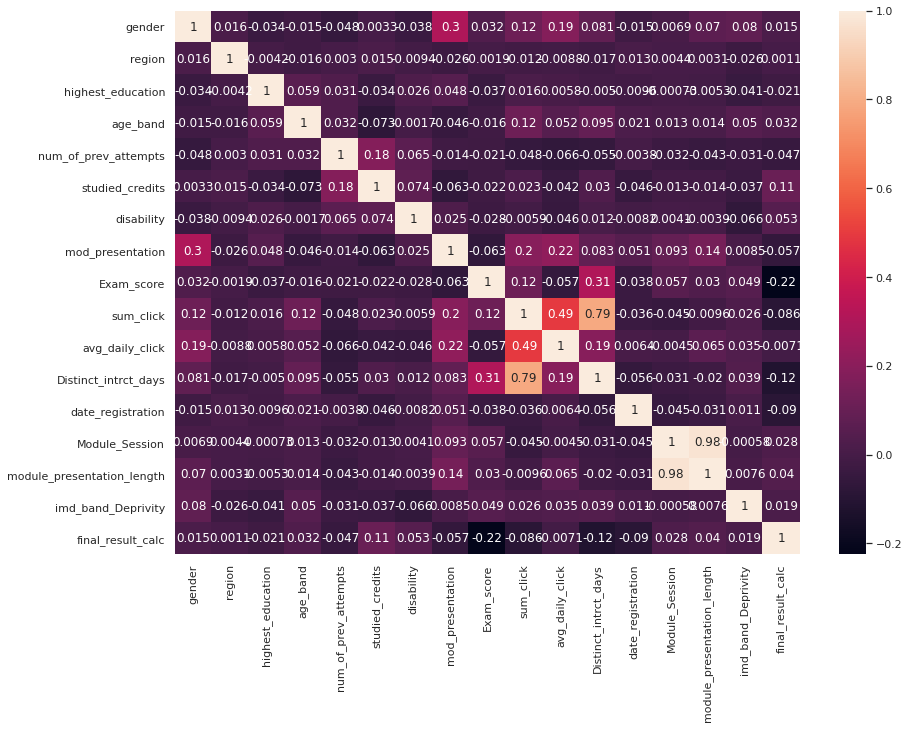

In [251]:
# Create a correlation matrix, we will leave the correlation we expect it
plt.figure(figsize=(14,10))
sns.heatmap(reg_std_FW_X.corr(),annot=True)

In [252]:
#get absolute value of correlation values
corr_matrix = reg_std_FW_X.corr().abs()

#get features and their correlated features into a matrix
upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape),k=1).astype(np.bool))

#drop features with correlation value greater than 0.5
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.5)]
print(); print(to_drop)



['Distinct_intrct_days', 'module_presentation_length']


From the above we have two features to drop with correlation coefficient greater than 0.5.

In [253]:
#dropping highly correlated features
reg_std_FW_X = reg_std_FW_X.drop(reg_std_FW_X[to_drop], axis=1)

Based on the outcome of our exploratory analysis, we understand that student who withdraw usually do not have exam score and due to this, we will be removing this feature from the dataset.

In [254]:
reg_std_FW_X = reg_std_FW_X.drop(['Exam_score'],axis=1)

### Remove features with low variance

In sklearn’s feature selection module we find VarianceThreshold. It removes all features whose variance doesn’t meet some threshold. By default it removes features with zero variance or features that have the same value for all samples.

In [255]:
from sklearn import feature_selection

sel = feature_selection.VarianceThreshold()
train_variance = sel.fit_transform(reg_std_FW_X)
train_variance.shape

(10142, 14)

In [256]:
reg_std_FW_X.var()

gender                  1.000099
region                  1.000099
highest_education       1.000099
age_band                1.000099
num_of_prev_attempts    1.000099
studied_credits         1.000099
disability              1.000099
mod_presentation        1.000099
sum_click               1.000099
avg_daily_click         1.000099
date_registration       1.000099
Module_Session          1.000099
imd_band_Deprivity      1.000099
final_result_calc       1.000099
dtype: float64

We observe uniform variance among all features in the dataset.

### Performing a Data Partition on a Sample Dataset

We will partition our data at a 70/30 rate. Training test takes 70% of the data while the test takes 30%.

In [257]:
#performing train test split
from sklearn.model_selection import train_test_split
#splitting the data into train test
Reg_X = reg_std_FW_X
Reg_Y = reg_std_FW_Y
#print the shape of the dataset
print(Reg_X.shape,Reg_Y.shape)


(10142, 14) (10142,)


In [258]:
#performing the train test split
Reg_X_train_std,Reg_X_test_std,Reg_Y_train_std,Reg_Y_test_std = train_test_split\
(Reg_X,Reg_Y, test_size=0.3, random_state=123)

In [259]:
#printing out shape of new subset
print(Reg_X_train_std.shape, Reg_X_test_std.shape, Reg_Y_train_std.shape, Reg_Y_test_std.shape)

(7099, 14) (3043, 14) (7099,) (3043,)


### Recursive Feature elimination RFE

##### Feature selection with the Lasso regression

In [260]:
from sklearn.linear_model import LassoCV
lcv = LassoCV()
lcv.fit(Reg_X_train_std, Reg_Y_train_std)
print(lcv.alpha_)

0.009569799575261325


In [261]:
mask = lcv.coef_ != 0
reduced_X_reg = Reg_X.loc[:, mask]

In [262]:
lcv.score(Reg_X_test_std, Reg_Y_test_std)

0.2991097890781328

In [263]:
lcv_mask = lcv.coef_!= 0
sum(lcv_mask)

14

##### Feature selection with the RandomForestRegressor

In [264]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
rfe_rf = RFE(estimator=RandomForestRegressor(),n_features_to_select=10, step=1, verbose=1)
rfe_rf.fit(Reg_X_train_std, Reg_Y_train_std)
rf_mask = rfe_rf.support_

Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.


##### Feature selection with GradientBoostingRegressor

In [265]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import GradientBoostingRegressor
rfe_gb = RFE(estimator=GradientBoostingRegressor(),n_features_to_select=10, step=1, verbose=1)
rfe_gb.fit(Reg_X_train_std, Reg_Y_train_std)
gb_mask = rfe_gb.support_

Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.


##### Combining selected features from all model
We will pick features that have more than 2 votes from the three model used.

In [266]:
import numpy as np
votes = np.sum([lcv_mask, rf_mask, gb_mask], axis=0)
print(votes)

[1 3 3 3 3 3 1 3 3 3 3 1 1 3]


In [267]:
len(Reg_Y_test_std)

3043

In [268]:
mask = votes >= 2
reduced_X_reg = Reg_X.loc[:, mask]

##### Final Features for regression

In [269]:
reduced_X_reg.columns

Index(['region', 'highest_education', 'age_band', 'num_of_prev_attempts',
       'studied_credits', 'mod_presentation', 'sum_click', 'avg_daily_click',
       'date_registration', 'final_result_calc'],
      dtype='object')

In [270]:
#performing the train test split
Reg_X_train_std,Reg_X_test_std,Reg_Y_train_std,Reg_Y_test_std = train_test_split\
(reduced_X_reg,Reg_Y, test_size=0.3, random_state=123)

### Support Vector Regression.

In [271]:
from sklearn import svm
from sklearn.metrics import mean_squared_error, mean_absolute_error

#instantiate the support vect
regr = svm.SVR()
regr.fit(Reg_X_train_std, Reg_Y_train_std)

SVR()

In [272]:
#Return the coefficient of determination of the training set.
regr.score(Reg_X_train_std,Reg_Y_train_std)

0.4031227173475094

In [273]:
#Return the coefficient of determination  of the test set.
regr.score(Reg_X_test_std,Reg_Y_test_std)

0.3880998420708016

In [274]:
y_pred_reg = regr.predict(Reg_X_test_std)

In [275]:
#return the mean squared error
mean_squared_error(Reg_Y_test_std,y_pred_reg)

277.0740272652407

### GradientBoostingRegressor

In [276]:
from sklearn.ensemble import GradientBoostingRegressor

In [277]:
#instantiate and fit the model
GB = GradientBoostingRegressor(random_state=0)

GB.fit(Reg_X_train_std, Reg_Y_train_std)


GradientBoostingRegressor(random_state=0)

In [278]:
#Return the coefficient of determination R-squared of the train set.
GB.score(Reg_X_train_std, Reg_Y_train_std)

0.5607302304872968

In [279]:
#Return the coefficient of determination R-squared of the test set.
GB.score(Reg_X_test_std, Reg_Y_test_std)

0.5059863815186556

In [280]:
#get the mean squared error
y_pred_gb_reg = GB.predict(Reg_X_test_std)
mean_squared_error(Reg_Y_test_std,y_pred_gb_reg)

223.69391643846927

### RandomForestRegressor

In [281]:
#import function
from sklearn.ensemble import RandomForestRegressor

In [282]:
#instantiate the model
RF_Reg = RandomForestRegressor(max_depth=2, random_state=0)

In [283]:
#fit the model
RF_Reg.fit(Reg_X_train_std, Reg_Y_train_std)

RandomForestRegressor(max_depth=2, random_state=0)

In [284]:
#get the coefficient of determination R-squared of the train set.
RF_Reg.score(Reg_X_train_std, Reg_Y_train_std)

0.3158172262455219

In [285]:
#get the coefficient of determination R-squared of the test set.
RF_Reg.score(Reg_X_test_std, Reg_Y_test_std)

0.29225896227028636

In [286]:
#get the mean square error
y_pred_RF_Reg = RF_Reg.predict(Reg_X_test_std)
mean_squared_error(Reg_Y_test_std,y_pred_RF_Reg)

320.4716603576075

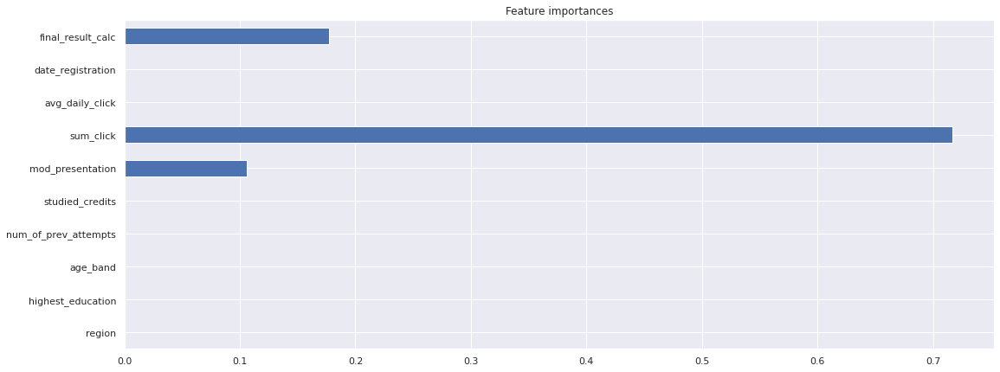

In [287]:

rf_feature_importances_ = pd.Series(RF_Reg.feature_importances_,
 index = reduced_X_reg.columns)
_ = rf_feature_importances_.plot(kind = 'barh')
_ = plt.title("Feature importances")

# 3.0 Results and Discussion

### Unsupervised Analysis

<strong>KMeans Algorithm</strong>
The KMeans Algorithm was used to cluster the Student information table,  and VLE resources. The elbow method was used to decide the optimum number of clusters.<br/>
* Student Information: The KMeans clustering was performed on the Principal Component Projections of the student information dataset. We observe 3 clusters in this dataset, a semi unsupervised approach was attempted by plotting the datapoints on a scatterplot and group them by the class of final result they belong to, we compared this with the scatterplot of the datapoints grouped by the KMeans cluster label. We observe similar structure. Cross tabulating the KMeans cluster label and the final result classes showed that we have all 3 classes of Pass, Fail and Withdrawn were reperesented on all three clusters although we the Pass class had the highest amount on all three clusters, Fail had a higher occurence than the Withdrawn class. We observe that on the clusters the Fail and Withdrawn datapoints occur in similar locations on the dataspace. 

* VLE Resources: The KMeans clustering was performed on the Principal Component Projections of the VLE Resources dataset. We observe 3 clusters in this dataset, a semi unsupervised approach was attempted by plotting the datapoints on a scatterplot and group them by the module session i.e courses starting in February and those starting in october. Cross tabulating the output of the clusters showed that we have both module sessions J and B occuring in all three clusters.

<strong>Hierarchical Clustering</strong>
Hierarchical clustering was used on all three datasets. We used the dendrogram for the module presentation data.<br/>
* Student Information: Implementing the Hierarchical clustering on this dataset using the number of clusters gotten from the elbow method of the KMeans algorithm showed similar results with the KMeans algorithm. The scatterplot of the datapoints grouped by the final result class was similar to that of the datapoints grouped by the output of the hierarchical clustering. We crosstabulated the cluster labels and the final result class count of each cluster. We observed similar patterns as seen witht the KMeans implementation, but for hierarchical clustering cluster 1 had the highest amount of datapoints grouped to it.

* VLE Resources:We approached this task with a semi unsupervised learning technique, we tried to see if we can cluster the datapoints into the two module sessions based on the average daily clicks of the students. We used 3 clusters which was gotten from the elbow method of the KMeans algorithm. Cross tabulating the output showed that we have an occurence of both module sessions in all clusters, which is in line with the observations from the KMeans implementation of this task. Cluster 2 had the highest amount of datapoints grouped to it.


* Module Presentation: A dendrogram was built using this dataset, we used both single and complete linkage method for the building of the dendrogram. We observe that for the complete linkage dendrogram the highest height of the cluster was at around 5 while that of the single linkage was approximately half of that. Complete linkage show we have 5 different clusters in the dataset combining all the hierachies from the root, while the single linkage shows we have 6 different clusters. Since the height for the single linkage cluster is lower than that of the complete, we will adhere to the 6 clusters derived from the Single linkage.


<strong>MeanShift Algorithm</strong>
The Meanshift algorithm was used to perform a clustering task on the student information dataset. We observe a very high number of differnt clusters using this method which means the algorithm was unable to generalize the datapoints. The scatterplot showed a spectrum of the different clusters which had a similar pattern to the plot from the other clusters.<br/>
<strong>DBSCAN Algorithm</strong>
The DBSAN algorithm performed similarly to the MeanShift clustering. We were unable to generalize the datapoints using this algorithm.<br/>

### Supervised Classification 

<strong>Naive Bayes classifier</strong>
We started the modelling process on the selected features using the Naive Bayes classifier. We observed a model accuracy score of 54% and a Training set score of 55% which shows no evidence of overfitting. The null accuracy of the model was 55% which showed that our model will not perform better than randomly selecting the most common class in the dataset.<br/>
From the confusion matrix we observed that:
* True Positives: We successfully classified 243 failed students with the right label and 883 withdrawn students to the right label.
* False Positives: We observe a high occurence of false positive for students who failed which is the reason for not having a better model than selecting the most frequent class. We observe a low occurence of false positive for the Withdrawn class 38.

Error analysis of our model showed that:
* Our model had an Accuracy of 55% for both training and the test set.
* We observed a Precision of 50% for the train test and 49% for the test set.
* The recall was 97% for the train set and 95% for the test set.



<strong>Decision Trees</strong>
The Decision Trees classifier was used to classify students into final result class. This model had a train set accuracy score of 66% and a test score of 65% which shows no sign of overfitting. We observe that the most important feature was the weighted assessment grade and the null accuracy of the model showed that this model is better than selecting the most common class in the dataset.

From the confusion matrix we observed that:
* True Positives: We successfully classified 649 failed students with the right label and 678 withdrawn students to the right label.
* False Positives:We have 225 False positives for the Fail class and 477 False positive for Withdrawn students.

Error analysis of our model showed that:
* Our model had a Accuracy of approximately 66% for both training and test set.
* We observed a Precision of 59% for the train test and 58% for the test set.
* The recall was 76% for the train set and 75% for the test set.


<strong>Support Vector Machine Algorithm</strong>
This algorithm was used to classify the dataset, we observed a training accuracy of 68% and test set accuracy of 68%. The null accuracy test showed that this model is better than randomly selecting the most common class.

From the confusion matrix we observed that:
* True Positives: We successfully classified 757 failed students with the right label and 639 withdrawn students to the right label.
* False Positives:We observe 264 false positives for withdrawn and 369 false positives for students who failed.

Error analysis of our model showed that:
* This model had a Accuracy of approximately 69% for training set and 69% for the test set.
* The presicion of this model was 63% for the training set and 63% for the test set.
* The recall was approximately 70% for both the train set and test set.



### Supervised Regression 

R-squared is the percentage of the dependent variable variation that the model explains. The mean squared error tells us the closeness of our fitted regression line to the datapoints.<br/>
<strong>Support Vector Regression:</strong>
This model showed an R-squared of 40% on the training test and 38% on the test set. The mean squared error was 277.<br/>
<strong>GradientBoostingRegressor:</strong>
An R-squared of 56% was observed for the training test and 50% for the test set. The mean squared error was 233.7.<br/>
<strong>RandomForestRegressor:</strong>
The random forest regressor gave an R-squared error of 31% on the train set and 29% on the test set. The mean squared error was 320.<br/>

# 4.0 Conclusion

### Unsupervised Analysis
**Unsupervised Analysis of Student Information**
* The outcome of the silhouette_score Evaluation and calinski_harabasz_score Evaluation showed that the KMeans algorithm was the best model to implement on this dataset. The KMeans algorithm had the highest value between -1 and 1 and also had the highest value from the calinski_harabasz_score Evaluation.

**Unsupervised Analysis of VLE Resources**
* The KMeans algorithm performed better than the Hierarchical clustering used, We observed a higher score on both the silhouette_score Evaluation and the calinski_harabasz_score Evaluation.

**Unsupervised Analysis of Module Presentation**
* The denrogram showed that the optimum number of clusters for this dataset is 6 clusters which was gotten from the single linkage method.

-------------------------------------------------------------------------------------------------------------------

### Supervised Analysis
**Regression**
The aim of this task was to predict the assessment weight of the students that failed or withdraw from a course, the evaluation metrics performed on all models used for this task showed that we do not have a good model to preduct Fail or withdrawal. We observed low R-Squared for all the models and a very high mean squared error, which means our model has a very low accuracy. None of the model used for this task performed well on this regression task.

**Classification**
The aim of this task was to predict the if a student would fail or withdraw from a course. Three different models were implemented, two of our models performed better than the null model. The best model for this dataset was the support vector machines algorithm which had a training set accuracy of 68% and test set accuracy of 68% which were the highest among all models implemented.

# 5.0 Future work and Recommendations

We were able to perform unsupervised learning on the dataset successfully, we got a final model accuracy of 68% using the support vector machines algorithm but we were unsuccessful with predicting the weighted assessment score of the students who failed and withdrew from the courses in this dataset. Based on the time constraint on the delivery of this report we were unable to explore further methods to get better results, the accuracy would also have been aided if some domain and expert consultation on online course design and performance could have gotten on making selecting the important features. 
Further exploration would be needed to achieve this goal:
* We need to investigate the relationship between the Fail and Withdrawal class, and output of the confusion matrix. Do we have a relationship between the student demography and vle activities of this class. This would help clarify if our model was not accurate because of high similarity between the two classes and help decide the best line of action for performing the predictions.
* Perform a classification and regression task on predicting if a student would Pass or either fail or withdraw.
* Analyze the clusters using the different categorical features and see how the clusters group these features.
* Explore the Module presentation clusters and predict the student performance on each of the module presentation.
* Rerun all models with only important features derived from the implementation of the different algorithms.
* Hyperparameter tuning

#### Some assumptions to investigate reasons for student failure
* Can we make upstream efforts to detect students who will withdraw based on their interactions with the resources on the VLE?
* Can we predict students that will withdraw based on their TMA and CMA assessments even before the exams?
* Can we predict if a student will pass or fail based on their interaction with the vle?
* Can we predict students that will pass the overall course based on their performance on the TMA and CMA assessments?
* Can we detect a pattern among top users of the vle platform?
* Is there an optimum number of days for students to submit their assessments to be guranteed a higher chance os passing the assessment?
* Does the number of courses taken by a student affect their grades?
* Do students who register early stand a better chance of passing?
* Is there a difference between the passing rate of students registered for the February courses and those registered for the October courses?
* Does the IMD band of the students location affect their chances of passing? and does it affect their chances of withdrawal and how can this be remedied?